In [11]:
!pip install version_information

You are using pip version 9.0.1, however version 10.0.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [12]:
#https://ipyton.org/ipython-docdex/config/extsions/autoreload.html
%reload_ext autoreload
%autoreload 2

#version information
%reload_ext version_information
%version_information Cython, matplotlib, numpy, pandas,  qutip, seaborn, scipy, sklearn, tqdm, version_information,

Software,Version
Python,3.6.4 64bit [GCC 7.2.0]
IPython,6.3.1
OS,Linux 4.9.87 linuxkit aufs x86_64 with debian stretch sid
Cython,0.28.2
matplotlib,2.1.2
numpy,1.13.3
pandas,0.22.0
qutip,The 'qutip' distribution was not found and is required by the application
seaborn,0.8.1
scipy,1.0.1


In [13]:
%matplotlib inline
import numpy as np
import scipy as sp
import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from six.moves import range

# Setup Pandas
pd.set_option('display.width', 500)
pd.set_option('display.max_columns', 100)
pd.set_option('display.notebook_repr_html', True)

# Setup Seaborn
sns.set_style("whitegrid")
sns.set_context("poster")

In [14]:
trump_new = pd.read_csv('trump_15_may_2018.csv', sep=';')


In [15]:
trump = pd.read_csv('Donald-Tweets.csv')

In [16]:
trump

,Date,Time,Tweet_Text,Type,Media_Type,Hashtags,Tweet_Id,Tweet_Url,twt_favourites_IS_THIS_LIKE_QUESTION_MARK,Retweets,Unnamed: 10,Unnamed: 11
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,photo,ThankAVet,7.970000e+17,https://twitter.com/realDonaldTrump/status/797...,127213,41112,NaN,NaN
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,NaN,NaN,7.970000e+17,https://twitter.com/realDonaldTrump/status/797...,141527,28654,NaN,NaN
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,NaN,NaN,7.970000e+17,https://twitter.com/realDonaldTrump/status/797...,183729,50039,NaN,NaN
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,NaN,NaN,7.970000e+17,https://twitter.com/realDonaldTrump/status/796...,214001,67010,NaN,NaN
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,NaN,NaN,7.970000e+17,https://twitter.com/realDonaldTrump/status/796...,178499,36688,NaN,NaN
5,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,photo,NaN,7.970000e+17,https://twitter.com/realDonaldTrump/status/796...,159176,44655,NaN,NaN
6,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,NaN,NaN,7.960000e+17,https://twitter.com/realDonaldTrump/status/796...,627615,225164,NaN,NaN
7,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,photo,ElectionNight;MAGA,7.960000e+17,https://twitter.com/realDonaldTrump/status/796...,185160,45492,NaN,NaN
8,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,NaN,NaN,7.960000e+17,https://twitter.com/realDonaldTrump/status/796...,99809,17169,NaN,NaN
9,16-11-08,23:20:39,RT @EricTrump: Join my family in this incredib...,text,NaN,MakeAmericaGreatAgain;VOTE,7.960000e+17,https://twitter.com/realDonaldTrump/status/796...,63868,19710,NaN,NaN


In [17]:
trump.size

88500

In [18]:
dft = trump.copy()
dft['sentiment']='unknown'



In [19]:
dft.columns

Index(['Date', 'Time', 'Tweet_Text', 'Type', 'Media_Type', 'Hashtags', 'Tweet_Id', 'Tweet_Url', 'twt_favourites_IS_THIS_LIKE_QUESTION_MARK', 'Retweets', 'Unnamed: 10', 'Unnamed: 11', 'sentiment'], dtype='object')

In [20]:
dft=dft.drop([ 'Media_Type' , 'Hashtags' ,'Media_Type' ,'Tweet_Id' , 'Tweet_Url' , 'twt_favourites_IS_THIS_LIKE_QUESTION_MARK' ,'Unnamed: 10' , 'Unnamed: 11'], axis=1)

In [21]:
# mini frame to practice on
df_mini=dft.head(10)

In [22]:
df_mini

,Date,Time,Tweet_Text,Type,Retweets,sentiment
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown
5,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,44655,unknown
6,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,225164,unknown
7,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,45492,unknown
8,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,17169,unknown
9,16-11-08,23:20:39,RT @EricTrump: Join my family in this incredib...,text,19710,unknown


In [23]:
! pip install nltk

    100% |████████████████████████████████| 1.4MB 1.1MB/s eta 0:00:01    35% |███████████▎                    | 491kB 7.9MB/s eta 0:00:01
  Running setup.py bdist_wheel for nltk ... done
  Stored in directory: /home/jovyan/.cache/pip/wheels/d1/ab/40/3bceea46922767e42986aef7606a600538ca80de6062dc266c
Successfully built nltk
You are using pip version 9.0.1, however version 10.0.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [24]:
! pip install twython

    100% |████████████████████████████████| 122kB 2.0MB/s ta 0:00:01
  Running setup.py bdist_wheel for twython ... done
  Stored in directory: /home/jovyan/.cache/pip/wheels/c2/b0/a3/5c4b4b87b8c9e4d99f1494a0b471f0134a74e5fb33d426d009
Successfully built twython
You are using pip version 9.0.1, however version 10.0.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [25]:
import nltk
from nltk.classify import NaiveBayesClassifier
from nltk.corpus import subjectivity
from nltk.sentiment import SentimentAnalyzer
from nltk.sentiment.util import *

In [26]:
from nltk.corpus import opinion_lexicon
from nltk.tokenize import treebank

In [27]:
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /home/jovyan/nltk_data...


True

In [28]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from nltk import tokenize
sid = SentimentIntensityAnalyzer()


#Only for use in Python 2.6.0a2 and later
from __future__ import print_function




In [29]:
def sentiment_vader_inplace( dataframe , tweet_col):
    '''function to get sentiment for each tweet
    takes 2 inputs: dataframe to add sentiment to , column with tweets
    adds a column to data from fro sentiment with  pos, neg or nea. Only gives nea if no score for pos or neg'''
    
    #make column for sentiments
    dataframe['sentiment_vader']=None
    
    #loop through length of tweets pass
    for i in range(len( dataframe ) ):
        
        ss = sid.polarity_scores(dataframe[tweet_col][i]) #get polarity score for tweet (neg,pos,nea,compound)
        
        dataframe.loc[i,'sentiment_vader'] =ss['compound'] # if the negative score is higher assign neg
            
         
   
sentiment_vader_inplace( df_mini, 'Tweet_Text' )       

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  import sys
/opt/conda/lib/python3.6/site-packages/pandas/core/indexing.py:537: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


In [30]:
df_mini

,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown,0.3367
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown,0.9299
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown,-0.5141
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown,0.9354
5,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,44655,unknown,0.795
6,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,225164,unknown,0.4926
7,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,45492,unknown,0
8,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,17169,unknown,0.5242
9,16-11-08,23:20:39,RT @EricTrump: Join my family in this incredib...,text,19710,unknown,0.6876


# NER

In [31]:
from nltk import word_tokenize, pos_tag

In [35]:
! pip install spacy

    100% |████████████████████████████████| 17.6MB 91kB/s  eta 0:00:01  5% |█▉                              | 993kB 4.8MB/s eta 0:00:04
    100% |████████████████████████████████| 92kB 9.2MB/s eta 0:00:01
    100% |████████████████████████████████| 1.2MB 1.1MB/s ta 0:00:011
    100% |████████████████████████████████| 51kB 8.2MB/s eta 0:00:01
    100% |████████████████████████████████| 194kB 5.3MB/s eta 0:00:01
    100% |████████████████████████████████| 604kB 1.4MB/s eta 0:00:01
    100% |████████████████████████████████| 389kB 2.5MB/s eta 0:00:01
    100% |████████████████████████████████| 143kB 4.6MB/s ta 0:00:01
  Running setup.py bdist_wheel for spacy ... done
  Stored in directory: /home/jovyan/.cache/pip/wheels/fb/00/28/75c85d5135e7d9a100639137d1847d41e914ed16c962d467e4
  Running setup.py bdist_wheel for murmurhash ... done
  Stored in directory: /home/jovyan/.cache/pip/wheels/b8/94/a4/f69f8664cdc1098603df44771b7fec5fd1b3d8364cdd83f512
  Running setup.py bdist_wheel for cymem ...

In [32]:
! pip list

DEPRECATION: The default format will switch to columns in the future. You can use --format=(legacy|columns) (or define a format=(legacy|columns) in your pip.conf under the [list] section) to disable this warning.
alembic (0.9.9)
asn1crypto (0.24.0)
backcall (0.1.0)
backports.functools-lru-cache (1.5)
beautifulsoup4 (4.6.0)
bleach (2.1.3)
bokeh (0.12.15)
certifi (2018.4.16)
cffi (1.11.4)
chardet (3.0.4)
cloudpickle (0.5.2)
conda (4.4.10)
cryptography (2.1.4)
cycler (0.10.0)
Cython (0.28.2)
dask (0.17.4)
decorator (4.3.0)
dill (0.2.7.1)
entrypoints (0.2.3)
fastcache (1.0.2)
gmpy2 (2.0.8)
h5py (2.7.1)
html5lib (1.0.1)
idna (2.6)
imageio (2.3.0)
ipykernel (4.8.2)
ipython (6.3.1)
ipython-genutils (0.2.0)
ipywidgets (7.2.1)
jedi (0.12.0)
Jinja2 (2.10)
jsonschema (2.6.0)
jupyter (1.0.0)
jupyter-client (5.2.3)
jupyter-console (5.2.0)
jupyter-core (4.4.0)
jupyterhub (0.8.1)
jupyterlab (0.32.1)
jupyterlab-launcher (0.10.5)
llvmlite (0.23.0)
Mako (1.0.7)
MarkupSafe (1.0)
matplotlib (2.1.2)
mistun

In [36]:
! python -m spacy download en_core_web_sm

    100% |████████████████████████████████| 37.4MB 2.4MB/s ta 0:00:011 3% |█                               | 1.2MB 1.2MB/s eta 0:00:30    10% |███▎                            | 3.8MB 14.8MB/s eta 0:00:03    10% |███▌                            | 4.0MB 1.3MB/s eta 0:00:27    14% |████▊                           | 5.6MB 1.2MB/s eta 0:00:26    17% |█████▊                          | 6.6MB 1.5MB/s eta 0:00:22    21% |██████▉                         | 8.0MB 2.0MB/s eta 0:00:15    26% |████████▋                       | 10.0MB 18.4MB/s eta 0:00:02    27% |████████▊                       | 10.2MB 2.2MB/s eta 0:00:13    28% |█████████                       | 10.5MB 4.3MB/s eta 0:00:07    30% |██████████                      | 11.6MB 11.5MB/s eta 0:00:03    38% |████████████▏                   | 14.2MB 11.0MB/s eta 0:00:03    40% |█████████████▏                  | 15.3MB 1.8MB/s eta 0:00:13    48% |███████████████▋                | 18.2MB 11.0MB/s eta 0:00:02    50% |████████████████▎            

In [43]:
import spacy

# Instantiate the English model: nlp
nlp = spacy.load('en_core_web_sm')#, tagger=False , parser=False , matcher=False )

# Create a new document: doc
#doc = nlp( article )

# Print all of the found entities and their labels
#for ent in doc.ents:
#    print(ent.label_, ent.text)

In [44]:
from collections import defaultdict

In [45]:
def spacy_ner_column(dataframe):
    """creats new column in dataframe with named entity label from scapy 
    """
    #default dict for all entity labels in dataframe
    all_spacy_ner = defaultdict(list)
    #create column for ner label
    dataframe['ner_spacy']=None
    
    l=len(dataframe) #get length to loop over
    for i in range(l-1):
        doc = nlp( dataframe.Tweet_Text[i] )#put tweet into unicode and tag ner
        for ent in doc.ents: #loop through doc ner tags
            tweet_ner = defaultdict(list) #create list to hold ner for one tweet
            tweet_ner[ent.label_].append(ent.text) #save ner to dict: key is label, value is text label
            dataframe.loc[i,'ner_spacy'] = [tweet_ner] #save tweet dict to dataframe column
            all_spacy_ner[ent.label_].append(ent.text) #save tweet ner to group of all scapy ner labels 
            
        

In [46]:
spacy_ner_column(dft)

In [47]:
spacy_ner_column(df_mini)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  import sys
/opt/conda/lib/python3.6/site-packages/pandas/core/indexing.py:537: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


In [48]:
df_mini

,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader,ner_spacy
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106,[{'DATE': ['Today']}]
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown,0.3367,[{'GPE': ['New York']}]
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown,0.9299,[{'TIME': ['last night']}]
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown,-0.5141,None
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown,0.9354,[{'GPE': ['Melania']}]
5,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,44655,unknown,0.795,[{'ORG': ['Marine Corps']}]
6,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,225164,unknown,0.4926,None
7,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,45492,unknown,0,[{'PERSON': ['MAGA']}]
8,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,17169,unknown,0.5242,[{'GPE': ['Election2']}]
9,16-11-08,23:20:39,RT @EricTrump: Join my family in this incredib...,text,19710,unknown,0.6876,None


# Cleaning Tweets 

In [49]:
column_name = "Tweet_Text"

In [50]:
df_mini[column_name][0].lower()

'today we express our deepest gratitude to all those who have served in our armed forces. #thankavet https://t.co/wpk7qwpk8z'

In [51]:
def clean_tweets_inplace(dataframe , column_name):
    """creats new column in dataframe with cleaned tweets"""
    dataframe['clean_tweet']= None
    l=len(dataframe)
    for i in range(l):
        
        clean_tweet = dataframe[column_name][i].lower()
        clean_tweet = re.sub( r"http.?://[^\s]+[\s]?" , "" , clean_tweet )
        clean_tweet = re.sub( r"@[^\s]+[\s]?", "" , clean_tweet )
        clean_tweet = re.sub( r"[\W'-]+", " " , clean_tweet )
        clean_tweet = re.sub( r"[0-9]", "" , clean_tweet )
        dataframe['clean_tweet'].iloc[i]= clean_tweet
    

In [52]:
clean_tweets_inplace(df_mini , "Tweet_Text")

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/opt/conda/lib/python3.6/site-packages/pandas/core/indexing.py:194: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#ind

In [53]:
df_mini

,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader,ner_spacy,clean_tweet
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106,[{'DATE': ['Today']}],today we express our deepest gratitude to all ...
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown,0.3367,[{'GPE': ['New York']}],busy day planned in new york will soon be maki...
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown,0.9299,[{'TIME': ['last night']}],love the fact that the small groups of protest...
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown,-0.5141,None,just had a very open and successful presidenti...
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown,0.9354,[{'GPE': ['Melania']}],a fantastic day in d c met with president obam...
5,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,44655,unknown,0.795,[{'ORG': ['Marine Corps']}],happy st birthday to the u s marine corps than...
6,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,225164,unknown,0.4926,None,such a beautiful and important evening the for...
7,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,45492,unknown,0,[{'PERSON': ['MAGA']}],watching the returns at pm electionnight maga__
8,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,17169,unknown,0.5242,[{'GPE': ['Election2']}],rt such a surreal moment to vote for my father...
9,16-11-08,23:20:39,RT @EricTrump: Join my family in this incredib...,text,19710,unknown,0.6876,None,rt join my family in this incredible movement ...


In [33]:

nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /home/jovyan/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /home/jovyan/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /home/jovyan/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [34]:
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords

def token_lem_stop_tweets_col(dataframe):
    """creats new column in dataframe with tokenized, and lemmatized words 
    excluding stop word (not intentional left in)"""
    wnl = WordNetLemmatizer()
    
    stop_words = set( nltk.corpus.stopwords.words("english") )
    stop_words.remove("not")
    
    dataframe['token_tweet']=None
    l=len(dataframe)
    for i in range(l):
        token_tweets= nltk.word_tokenize( dataframe.clean_tweet[i] )
        lemmed_tokens= [wnl.lemmatize(token) for token in token_tweets]
        token_stop = [ token for token in lemmed_tokens if not token in stop_words ]
        dataframe.token_tweet.iloc[i] = token_stop

In [35]:
token_lem_stop_tweets_col(df_mini)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if sys.path[0] == '':
/opt/conda/lib/python3.6/site-packages/pandas/core/indexing.py:194: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


Lets try spacy on the cleaned tweets

In [100]:
spy_ner_col_2(df_mini)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  import sys
/opt/conda/lib/python3.6/site-packages/pandas/core/indexing.py:537: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


In [102]:
spacy_ner_column(df_mini)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  import sys
/opt/conda/lib/python3.6/site-packages/pandas/core/indexing.py:537: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


# preprocessing datetime for bokeh
Currently bokeh does not take timestamps and pandas likes timestamps. We will have to convert

In [36]:
import datetime as dt

In [37]:
df_mini["timestamp"]=df_mini["Date"]+" "+df_mini["Time"]

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [38]:
df_mini.head(1)

,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader,ner_spacy,clean_tweet,token_tweet,timestamp
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106,[{'DATE': ['Today']}],today we express our deepest gratitude to all ...,"[today, express, deepest, gratitude, served, a...",16-11-11 15:26:37


In [39]:
for i in range( len( df_mini["timestamp"] ) ):
    df_mini.loc[i,"timestamp"]=dt.datetime.strptime(df_mini.loc[i,"timestamp"], "%y-%m-%d %H:%M:%S")

/opt/conda/lib/python3.6/site-packages/pandas/core/indexing.py:537: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


# plotting with bokeh



In [40]:
from bokeh.io import curdoc
from bokeh.models import ColumnDataSource
from bokeh.plotting import figure, show, output_notebook
output_notebook()

# Make the ColumnDataSource: source
source = ColumnDataSource( data ={
    'x'       :  df_mini.Date,
    'y'       : df_mini.sentiment_vader,
    
})

# set min and max date times for plotting
xmin = df_mini['timestamp'].min() #- pd.Timedelta(days=0.1*N)
xmax = df_mini['timestamp'].max() #+ pd.Timedelta(days=0.1*N)



# Save the minimum and maximum values of the life expectancy column: ymin, ymax
ymin, ymax = min( df_mini.sentiment_vader ) , max( df_mini.sentiment_vader )

# Create the figure: plot
plot = figure( title = 'Trump Sentiment' , plot_height = 400 , plot_width = 700 , x_axis_type='datetime',
              x_range = (xmin, xmax), y_range = ( ymin , ymax ) )

# Add circle glyphs to the plot

plot.circle( df_mini.timestamp , df_mini['sentiment_vader'])
# Set the x-axis label
plot.xaxis.axis_label ='Date'

# Set the y-axis label
plot.yaxis.axis_label = 'sentiment_vader'

# Add the plot to the current document and add a title
curdoc().add_root(plot)
curdoc().title = 'Sentiment (nltk:vader)'

show(plot)

Loading BokehJS ...

Lets see if we can do better at NER. The Scapy one was not very impressive.

In [105]:
#first gather all word tokens
df_mini.token_tweet[0]

['today',
 'express',
 'deepest',
 'gratitude',
 'served',
 'armed',
 'force',
 'thankavet']

In [108]:
#need to download a new tagger 
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/jovyan/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


True

In [173]:
df_mini.token_tweet[0]

['today',
 'express',
 'deepest',
 'gratitude',
 'served',
 'armed',
 'force',
 'thankavet']

In [182]:
df_mini.chunks.iloc[0] 

In [179]:
for i in range( len( df_mini )):
    print( df_mini['token_tweet'][i] )



['today', 'express', 'deepest', 'gratitude', 'served', 'armed', 'force', 'thankavet']
['busy', 'day', 'planned', 'new', 'york', 'soon', 'making', 'important', 'decision', 'people', 'running', 'government']
['love', 'fact', 'small', 'group', 'protester', 'last', 'night', 'passion', 'great', 'country', 'come', 'together', 'proud']
['open', 'successful', 'presidential', 'election', 'professional', 'protester', 'incited', 'medium', 'protesting', 'unfair']
['fantastic', 'day', 'c', 'met', 'president', 'obama', 'first', 'time', 'really', 'good', 'meeting', 'great', 'chemistry', 'melania', 'liked', 'mr', 'lot']
['happy', 'st', 'birthday', 'u', 'marine', 'corp', 'thank', 'service']
['beautiful', 'important', 'evening', 'forgotten', 'man', 'woman', 'never', 'forgotten', 'come', 'together', 'never']
['watching', 'return', 'pm', 'electionnight', 'maga__']
['rt', 'surreal', 'moment', 'vote', 'father', 'president', 'united', 'state', 'make', 'voice', 'heard', 'vote', 'election_']
['rt', 'join', 'fa

In [187]:
tagged = nltk.pos_tag(df_mini.token_tweet[1])

#define what to look for: everything expect these things
chunk =  r"""Chunk: {<.*>+}
                                    }<VB.?|IN|DT|TO|PRP|CC|WP|CC|WP|RB|MD|PRP$|PRT>+{"""


chunkParser = nltk.RegexpParser(chunk) #parse
chunked = chunkParser.parse(tagged) #
            
        
for subtree in chunked.subtrees(filter=lambda t: t.label() == 'Chunk'):
        print(subtree)
        

(Chunk busy/JJ day/NN)
(Chunk new/JJ york/NN)
(Chunk important/JJ decision/NN people/NNS)
(Chunk government/NN)


In [210]:
df_mini.chunks[1]

['(Chunk busy/JJ day/NN)',
 '(Chunk new/JJ york/NN)',
 '(Chunk important/JJ decision/NN people/NNS)',
 '(Chunk government/NN)']

In [204]:
# use nltk to tag tokenized word from tweets
def chuck_it (dataframe, col_name):
    chunks_all=[]
    dataframe['chunks']=None
    for i in range( len( dataframe ) ):
        
        #list to catch all topic in tweet
        tweet_topic=[]
        tagged = nltk.pos_tag(dataframe[col_name][i])

#define what to look for: everything expect these things
        chunk =  r"""Chunk: {<.*>+}
                                    }<VB.?|IN|DT|TO|PRP|CC|WP|CC|WP|RB|MD|PRP$|PRT>+{"""


        chunkParser = nltk.RegexpParser(chunk) #parse
        chunked = chunkParser.parse(tagged) #
            
        
        for subtree in chunked.subtrees(filter=lambda t: t.label() == 'Chunk'):
            tweet_topic.append(str(subtree))
        dataframe.chunks.iloc[i] = tweet_topic
        chunks_all.append(tweet_topic)
            


In [205]:
chuck_it(df_mini , 'token_tweet')

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.
/opt/conda/lib/python3.6/site-packages/pandas/core/indexing.py:194: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [206]:
df_mini

,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader,ner_spacy,clean_tweet,token_tweet,timestamp,ner_spacy_2,chunks
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106,[{'DATE': ['Today']}],today we express our deepest gratitude to all ...,"[today, express, deepest, gratitude, served, a...",2016-11-11 15:26:37,[{'DATE': ['today']}],"[(Chunk today/NN), (Chunk deepest/JJS gratitud..."
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown,0.3367,[{'GPE': ['New York']}],busy day planned in new york will soon be maki...,"[busy, day, planned, new, york, soon, making, ...",2016-11-11 13:33:35,None,"[(Chunk busy/JJ day/NN), (Chunk new/JJ york/NN..."
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown,0.9299,[{'TIME': ['last night']}],love the fact that the small groups of protest...,"[love, fact, small, group, protester, last, ni...",2016-11-11 11:14:20,[{'TIME': ['last night']}],[(Chunk\n fact/NN\n small/JJ\n group/NN\n ...
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown,-0.5141,None,just had a very open and successful presidenti...,"[open, successful, presidential, election, pro...",2016-11-11 02:19:44,None,[(Chunk\n open/JJ\n successful/JJ\n preside...
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown,0.9354,[{'GPE': ['Melania']}],a fantastic day in d c met with president obam...,"[fantastic, day, c, met, president, obama, fir...",2016-11-11 02:10:46,[{'ORDINAL': ['first']}],"[(Chunk fantastic/JJ day/NN), (Chunk president..."
5,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,44655,unknown,0.795,[{'ORG': ['Marine Corps']}],happy st birthday to the u s marine corps than...,"[happy, st, birthday, u, marine, corp, thank, ...",2016-11-10 19:31:27,None,[(Chunk\n happy/JJ\n st/NN\n birthday/NN\n ...
6,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,225164,unknown,0.4926,None,such a beautiful and important evening the for...,"[beautiful, important, evening, forgotten, man...",2016-11-09 11:36:58,None,[(Chunk\n beautiful/JJ\n important/JJ\n eve...
7,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,45492,unknown,0,[{'PERSON': ['MAGA']}],watching the returns at pm electionnight maga__,"[watching, return, pm, electionnight, maga__]",2016-11-09 02:48:27,[{'TIME': [' pm']}],"[(Chunk return/NN pm/NN), (Chunk maga__/NNS)]"
8,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,17169,unknown,0.5242,[{'GPE': ['Election2']}],rt such a surreal moment to vote for my father...,"[rt, surreal, moment, vote, father, president,...",2016-11-09 01:35:15,None,[(Chunk\n rt/NN\n surreal/JJ\n moment/NN\n ...
9,16-11-08,23:20:39,RT @EricTrump: Join my family in this incredib...,text,19710,unknown,0.6876,None,rt join my family in this incredible movement ...,"[rt, join, family, incredible, movement, makea...",2016-11-08 23:20:39,None,[(Chunk\n rt/NN\n join/NNS\n family/NN\n i...


In [41]:
df_mini['timestamp'].max()

datetime.datetime(2016, 11, 11, 15, 26, 37)

In [42]:
df_mini

,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader,ner_spacy,clean_tweet,token_tweet,timestamp
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106,[{'DATE': ['Today']}],today we express our deepest gratitude to all ...,"[today, express, deepest, gratitude, served, a...",2016-11-11 15:26:37
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown,0.3367,[{'GPE': ['New York']}],busy day planned in new york will soon be maki...,"[busy, day, planned, new, york, soon, making, ...",2016-11-11 13:33:35
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown,0.9299,[{'TIME': ['last night']}],love the fact that the small groups of protest...,"[love, fact, small, group, protester, last, ni...",2016-11-11 11:14:20
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown,-0.5141,None,just had a very open and successful presidenti...,"[open, successful, presidential, election, pro...",2016-11-11 02:19:44
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown,0.9354,[{'GPE': ['Melania']}],a fantastic day in d c met with president obam...,"[fantastic, day, c, met, president, obama, fir...",2016-11-11 02:10:46
5,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,44655,unknown,0.795,[{'ORG': ['Marine Corps']}],happy st birthday to the u s marine corps than...,"[happy, st, birthday, u, marine, corp, thank, ...",2016-11-10 19:31:27
6,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,225164,unknown,0.4926,None,such a beautiful and important evening the for...,"[beautiful, important, evening, forgotten, man...",2016-11-09 11:36:58
7,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,45492,unknown,0,[{'PERSON': ['MAGA']}],watching the returns at pm electionnight maga__,"[watching, return, pm, electionnight, maga__]",2016-11-09 02:48:27
8,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,17169,unknown,0.5242,[{'GPE': ['Election2']}],rt such a surreal moment to vote for my father...,"[rt, surreal, moment, vote, father, president,...",2016-11-09 01:35:15
9,16-11-08,23:20:39,RT @EricTrump: Join my family in this incredib...,text,19710,unknown,0.6876,None,rt join my family in this incredible movement ...,"[rt, join, family, incredible, movement, makea...",2016-11-08 23:20:39


# Word 2 Vec

In [43]:
from gensim.corpora.dictionary import Dictionary

To get started, we have imported a few additional messy articles from Wikipedia, which were preprocessed by lowercasing all words, tokenizing them, and removing stop words and punctuation. These were then stored in a list of document tokens called articles

Obtain the id for "computer" from dictionary. To do this, use its .token2id method which returns ids from text, and then chain .get() which returns tokens from ids. Pass in "computer" as an argument to .get().
Use a list comprehension in which you iterate over articles to create a gensim MmCorpus from dictionary.
In the output expression, use the .doc2bow() method on dictionary with article as the argument.

In [59]:
#tokens_for_corpus
tokens_for_corpus=[]
for i in df_mini.token_tweet:
    tokens_for_corpus.append(i)
print (tokens_for_corpus)

[['today', 'express', 'deepest', 'gratitude', 'served', 'armed', 'force', 'thankavet'], ['busy', 'day', 'planned', 'new', 'york', 'soon', 'making', 'important', 'decision', 'people', 'running', 'government'], ['love', 'fact', 'small', 'group', 'protester', 'last', 'night', 'passion', 'great', 'country', 'come', 'together', 'proud'], ['open', 'successful', 'presidential', 'election', 'professional', 'protester', 'incited', 'medium', 'protesting', 'unfair'], ['fantastic', 'day', 'c', 'met', 'president', 'obama', 'first', 'time', 'really', 'good', 'meeting', 'great', 'chemistry', 'melania', 'liked', 'mr', 'lot'], ['happy', 'st', 'birthday', 'u', 'marine', 'corp', 'thank', 'service'], ['beautiful', 'important', 'evening', 'forgotten', 'man', 'woman', 'never', 'forgotten', 'come', 'together', 'never'], ['watching', 'return', 'pm', 'electionnight', 'maga__'], ['rt', 'surreal', 'moment', 'vote', 'father', 'president', 'united', 'state', 'make', 'voice', 'heard', 'vote', 'election_'], ['rt', '

In [62]:
#my_documents= [ " "]
#tokenized_docs= [ word_tokenize (doc.lower() ) for doc in my_documents ]
dictionary = Dictionary (tokens_for_corpus )
dictionary.token2id.get( "trump" )
corpus= [dictionary.doc2bow( doc ) for doc in tokens_for_corpus ]
#corpus = [dictionary.doc2bow( article ) for article in articles ]

# Print the first 10 word ids with their frequency counts from the fifth document
print(corpus[4][:10])


[(9, 1), (23, 1), (42, 1), (43, 1), (44, 1), (45, 1), (46, 1), (47, 1), (48, 1), (49, 1)]


In [79]:
tokenized_docs= [word_tokenize(doc.lower()) for doc in df_mini.Tweet_Text]
dictioanry = Dictionary (tokenized_docs)
computer_id=dictionary.token2id.get( "armed" )
print( dictionary.get( computer_id ) )
corpus = [dictionary.doc2bow( doc ) for doc in tokenized_docs ]

# Print the first 10 word ids with their frequency counts from the fifth document
print(corpus[0][:10])


armed
[(0, 1), (1, 1), (2, 1), (4, 1), (5, 1), (6, 1), (7, 1)]


In [63]:
#dictionary = Dictionary(articles)

# Select the id for "computer": computer_id
computer_id = dictionary.token2id.get( "trump" )

# Use computer_id with the dictionary to print the word
print( dictionary.get( computer_id ) )

# Create a MmCorpus: corpus
corpus = [dictionary.doc2bow( i ) for i in df_mini.token_tweet ]

# Print the first 10 word ids with their frequency counts from the fifth document
print(corpus[4][:10])


None
[(9, 1), (23, 1), (42, 1), (43, 1), (44, 1), (45, 1), (46, 1), (47, 1), (48, 1), (49, 1)]


In [84]:
from itertools import chain

In [57]:
from nltk.tokenize import word_tokenize

In [87]:
doc = corpus[4]

# Sort the doc for frequency: bow_doc
bow_doc = sorted(doc, key=lambda w: w[1], reverse=True)

# Print the top 5 words of the document alongside the count
for word_id, word_count in bow_doc[:5]:
    print(dictionary.get(word_id), word_count)
    
# Create the defaultdict: total_word_count
total_word_count = defaultdict(int)
for word_id, word_count in chain.from_iterable(corpus):
    total_word_count[word_id] += word_count

# Create a sorted list from the defaultdict: sorted_word_count
sorted_word_count = sorted(total_word_count.items() , key=lambda w: w[1], reverse=True) 

# Print the top 5 words across all documents alongside the count
for word_id, word_count in sorted_word_count[:5]:
    print(dictionary.get(word_id), word_count)


day 1
great 1
chemistry 1
fantastic 1
first 1
vote 3
day 2
important 2
come 2
great 2


In [225]:
sentences=[]
for i in range( len( df_mini ) ):
    
    sentences.append(df_mini.token_tweet[i])
print (sentences)

[['today', 'express', 'deepest', 'gratitude', 'served', 'armed', 'force', 'thankavet'], ['busy', 'day', 'planned', 'new', 'york', 'soon', 'making', 'important', 'decision', 'people', 'running', 'government'], ['love', 'fact', 'small', 'group', 'protester', 'last', 'night', 'passion', 'great', 'country', 'come', 'together', 'proud'], ['open', 'successful', 'presidential', 'election', 'professional', 'protester', 'incited', 'medium', 'protesting', 'unfair'], ['fantastic', 'day', 'c', 'met', 'president', 'obama', 'first', 'time', 'really', 'good', 'meeting', 'great', 'chemistry', 'melania', 'liked', 'mr', 'lot'], ['happy', 'st', 'birthday', 'u', 'marine', 'corp', 'thank', 'service'], ['beautiful', 'important', 'evening', 'forgotten', 'man', 'woman', 'never', 'forgotten', 'come', 'together', 'never'], ['watching', 'return', 'pm', 'electionnight', 'maga__'], ['rt', 'surreal', 'moment', 'vote', 'father', 'president', 'united', 'state', 'make', 'voice', 'heard', 'vote', 'election_'], ['rt', '

In [260]:

from gensim.models import Word2Vec
# define training data
sentences=[]
for i in range( len( df_mini ) ):
    
    sentences+=df_mini.token_tweet[i]

#sentences=[['this', 'is', 'the', 'first', 'sentence', 'for', 'word2vec'],['this', 'is', 'the', 'second', 'sentence'],['yet', 'another', 'sentence'],['one', 'more', 'sentence'],['and', 'the', 'final', 'sentence']]    
    
# train model
model = Word2Vec([sentences],  min_count=1)
# summarize the loaded model
print(model)
# summarize vocabulary
words = list(model.wv.vocab)
print(words)
# access vector for one word
print(model['armed'])
# save model
model.save('model.bin')
# load model
new_model = Word2Vec.load('model.bin')
print(new_model)

Word2Vec(vocab=96, size=100, alpha=0.025)
['today', 'express', 'deepest', 'gratitude', 'served', 'armed', 'force', 'thankavet', 'busy', 'day', 'planned', 'new', 'york', 'soon', 'making', 'important', 'decision', 'people', 'running', 'government', 'love', 'fact', 'small', 'group', 'protester', 'last', 'night', 'passion', 'great', 'country', 'come', 'together', 'proud', 'open', 'successful', 'presidential', 'election', 'professional', 'incited', 'medium', 'protesting', 'unfair', 'fantastic', 'c', 'met', 'president', 'obama', 'first', 'time', 'really', 'good', 'meeting', 'chemistry', 'melania', 'liked', 'mr', 'lot', 'happy', 'st', 'birthday', 'u', 'marine', 'corp', 'thank', 'service', 'beautiful', 'evening', 'forgotten', 'man', 'woman', 'never', 'watching', 'return', 'pm', 'electionnight', 'maga__', 'rt', 'surreal', 'moment', 'vote', 'father', 'united', 'state', 'make', 'voice', 'heard', 'election_', 'join', 'family', 'incredible', 'movement', 'makeamericagreatagain', 'please', 'america',

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:19: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).


In [262]:
X =model[model.wv.vocab]

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  """Entry point for launching an IPython kernel.


In [267]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
pca = PCA(n_components=2)
result = pca.fit_transform(X)

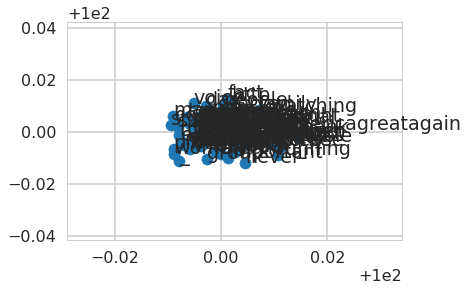

In [277]:
# create a scatter plot of the projection
plt.scatter(result[:, 0]+100, result[:, 1]+100)
words = list(model.wv.vocab)
for i, word in enumerate(words):
	plt.annotate(word, xy=(result[i, 0]+100, result[i, 1]+100))
plt.show()

GloVe is an unsupervised learning algorithm for obtaining vector representations for words. Training is performed on aggregated global word-word co-occurrence statistics from a corpus, and the resulting representations showcase interesting linear substructures of the word vector space.

citation: Jeffrey Pennington, Richard Socher, and Christopher D. Manning. 2014. GloVe: Global Vectors for Word Representation. [pdf] [bib]

Twitter (2B tweets, 27B tokens, 1.2M vocab, uncased, 25d, 50d, 100d, & 200d vectors, 1.42 GB download): glove.twitter.27B.zip

Training
The GloVe model is trained on the non-zero entries of a global word-word co-occurrence matrix, which tabulates how frequently words co-occur with one another in a given corpus. Populating this matrix requires a single pass through the entire corpus to collect the statistics. For large corpora, this pass can be computationally expensive, but it is a one-time up-front cost. Subsequent training iterations are much faster because the number of non-zero matrix entries is typically much smaller than the total number of words in the corpus.

GloVe is essentially a log-bilinear model with a weighted least-squares objective. The training objective of GloVe is to learn word vectors such that their dot product equals the logarithm of the words' probability of co-occurrence. Owing to the fact that the logarithm of a ratio equals the difference of logarithms, this objective associates (the logarithm of) ratios of co-occurrence probabilities with vector differences in the word vector space.

In [282]:

"""
Stanford’s GloVe Embedding
a pretrained corpus


"""
from gensim.scripts.glove2word2vec import glove2word2vec
glove_input_file = 'glove/glove.twitter.27B.25d.txt'
word2vec_output_file = 'glove/glove.twitter.27B.25d.txt.word2vec'
glove2word2vec(glove_input_file, word2vec_output_file)

(1193514, 25)

In [285]:

from gensim.models import KeyedVectors
# load the Stanford GloVe model
filename = 'glove/glove.twitter.27B.25d.txt.word2vec'
model = KeyedVectors.load_word2vec_format(filename, binary=False)
# calculate: (king - man) + woman = ?
result = model.most_similar(positive=['woman', 'king'], negative=['man'], topn=5)
print(result)

[('meets', 0.8841923475265503), ('prince', 0.832163393497467), ('queen', 0.8257461786270142), ('’s', 0.8174098134040833), ('crow', 0.8134994506835938)]


In [290]:
# wort2vec try two

from gensim.models import Word2Vec

word2vec.load(glove_input_file)
word2vec = None
dimensions = 0
word2vec = gensim.models.Word2Vec.load_word2vec_format(path_to_word2vec, binary=False)
word2vec.init_sims(replace=True)
word2vec.init_sims(replace=True)


NameError: name 'word2vec' is not defined

In [ ]:
if word not in self.word2vec.vocab:
            return None
self.word2vec.syn0norm[self.word2vec.vocab[word].index]

In [ ]:
if word1 not in self.word2vec.vocab or word2 not in self.word2vec.vocab:
            return None

        return self.word2vec.similarity(word1, word2)

In [ ]:
word2vec = Word2VecProvider()

# REPLACE PATH TO THE FILE
word2vec.load("C:\\__\\machinelearning\\glove.twitter.27B.200d.txt")

In [ ]:
! pip install --upgrade gensim

In [ ]:
sentences = ...
model = Word2Vec(sentences)

In [ ]:
words = list(model.wv.vocab)
print(words)

In [ ]:
print(model['word'])

In [ ]:
model.wv.save_word2vec_format('model.bin')

In [ ]:
model.wv.save_word2vec_format('model.txt', binary=False)


In [ ]:
model = Word2Vec.load('model.bin')

An alternative is to simply use an existing pre-trained word embedding.

Along with the paper and code for word2vec, Google also published a pre-trained word2vec model on the Word2Vec Google Code Project.

https://drive.google.com/file/d/0B7XkCwpI5KDYNlNUTTlSS21pQmM/edit?usp=sharing


from gensim.models import KeyedVectors
filename = 'GoogleNews-vectors-negative300.bin'
model = KeyedVectors.load_word2vec_format(filename, binary=True)

In [ ]:
from gensim.models import KeyedVectors

In [ ]:

from gensim.models import KeyedVectors
# load the Stanford GloVe model
filename = 'glove.6B.100d.txt.word2vec'
model = KeyedVectors.load_word2vec_format(filename, binary=False)
# calculate: (king - man) + woman = ?
result = model.most_similar(positive=['woman', 'king'], negative=['man'], topn=1)
print(result)
result = model.most_similar(positive=['woman', 'king'], negative=['man'], topn=1)
print(result)

Stanford researchers also have their own word embedding algorithm like word2vec called Global Vectors for Word Representation, or GloVe for short.

In [ ]:


1
2
3
4
from gensim.scripts.glove2word2vec import glove2word2vec
glove_input_file = 'glove.txt'
word2vec_output_file = 'word2vec.txt'
glove2word2vec(glove_input_file, word2vec_output_file)

In [ ]:

1
2
3
4
from gensim.scripts.glove2word2vec import glove2word2vec
glove_input_file = 'glove.6B.100d.txt'
word2vec_output_file = 'glove.6B.100d.txt.word2vec'
glove2word2vec(glove_input_file, word2vec_output_file)

In [ ]:

3
4
5
6
7
from gensim.models import KeyedVectors
# load the Stanford GloVe model
filename = 'glove.6B.100d.txt.word2vec'
model = KeyedVectors.load_word2vec_format(filename, binary=False)
# calculate: (king - man) + woman = ?
result = model.most_similar(positive=['woman', 'king'], negative=['man'], topn=1)
print(result)

In [ ]:
sentiment_vader_inplace( df_mini, 'Tweet_Text' )  

In [ ]:
spacy_ner_column(df_mini)

In [ ]:
clean_tweets_inplace(df_mini , "Tweet_Text")

In [ ]:
def token_lem_stop_tweets_col(dataframe)

In [421]:
#trump_new = pd.read_csv('Donald-Tweets.csv', sep=';')
#trump = pd.read_csv('Donald-Tweets.csv')
#dft = trump.copy()
dft['sentiment']='unknown'
dft.columns
#dft=dft.drop([ 'Media_Type' , 'Hashtags' ,'Media_Type' ,'Tweet_Id' , 'Tweet_Url' , 'twt_favourites_IS_THIS_LIKE_QUESTION_MARK' ,'Unnamed: 10' , 'Unnamed: 11'], axis=1)
sentiment_vader_inplace( dft, 'Tweet_Text' )       
spacy_ner_column(dft)

column_name = "Tweet_Text"
dft[column_name][0].lower()
clean_tweets_inplace(dft , "Tweet_Text")
token_lem_stop_tweets_col(dft)

#make a datetime object column
dft["timestamp"]=dft["Date"]+" "+dft["Time"]
for i in  tqdm (range( len( dft )-1 )):
    dft.loc[i,"timestamp"]=dt.datetime.strptime(dft.loc[i,"timestamp"], "%y-%m-%d %H:%M:%S")

/opt/conda/lib/python3.6/site-packages/pandas/core/indexing.py:194: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


KeyError: 'timestamp'

In [427]:
dft


,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader,ner_spacy,clean_tweet,token_tweet,timestamp
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106,[{'DATE': ['Today']}],today we express our deepest gratitude to all ...,"[today, express, deepest, gratitude, served, a...",None
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown,0.3367,[{'GPE': ['New York']}],busy day planned in new york will soon be maki...,"[busy, day, planned, new, york, soon, making, ...",None
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown,0.9299,[{'TIME': ['last night']}],love the fact that the small groups of protest...,"[love, fact, small, group, protester, last, ni...",None
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown,-0.5141,None,just had a very open and successful presidenti...,"[open, successful, presidential, election, pro...",None
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown,0.9354,[{'GPE': ['Melania']}],a fantastic day in d c met with president obam...,"[fantastic, day, c, met, president, obama, fir...",None
5,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,44655,unknown,0.795,[{'ORG': ['Marine Corps']}],happy st birthday to the u s marine corps than...,"[happy, st, birthday, u, marine, corp, thank, ...",None
6,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,225164,unknown,0.4926,None,such a beautiful and important evening the for...,"[beautiful, important, evening, forgotten, man...",None
7,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,45492,unknown,0,[{'PERSON': ['MAGA']}],watching the returns at pm electionnight maga__,"[watching, return, pm, electionnight, maga__]",None
8,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,17169,unknown,0.5242,[{'GPE': ['Election2']}],rt such a surreal moment to vote for my father...,"[rt, surreal, moment, vote, father, president,...",None
9,16-11-08,23:20:39,RT @EricTrump: Join my family in this incredib...,text,19710,unknown,0.6876,[{'GPE': ['America']}],rt join my family in this incredible movement ...,"[rt, join, family, incredible, movement, makea...",None


In [99]:
def spy_ner_col_2(dataframe):
    """creats new column in dataframe with named entity label from scapy 
    """
    #default dict for all entity labels in dataframe
    all_spacy_ner_2 = defaultdict(list)
    #create column for ner label
    dataframe['ner_spacy_2']=None
    
    l=len(dataframe) #get length to loop over
    for i in range(l-1):
        doc = nlp( dataframe.clean_tweet[i] )#put tweet into unicode and tag ner
        for ent in doc.ents: #loop through doc ner tags
            tweet_ner = defaultdict(list) #create list to hold ner for one tweet
            tweet_ner[ent.label_].append(ent.text) #save ner to dict: key is label, value is text label
            dataframe.loc[i,'ner_spacy_2'] = [tweet_ner] #save tweet dict to dataframe column
            all_spacy_ner_2[ent.label_].append(ent.text) #save tweet ner to group of all scapy ner labels 
            

In [292]:
df_mini

,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader,ner_spacy,clean_tweet,token_tweet,timestamp,ner_spacy_2,chunks
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106,[{'DATE': ['Today']}],today we express our deepest gratitude to all ...,"[today, express, deepest, gratitude, served, a...",2016-11-11 15:26:37,[{'DATE': ['today']}],"[(Chunk today/NN), (Chunk deepest/JJS gratitud..."
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown,0.3367,[{'GPE': ['New York']}],busy day planned in new york will soon be maki...,"[busy, day, planned, new, york, soon, making, ...",2016-11-11 13:33:35,None,"[(Chunk busy/JJ day/NN), (Chunk new/JJ york/NN..."
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown,0.9299,[{'TIME': ['last night']}],love the fact that the small groups of protest...,"[love, fact, small, group, protester, last, ni...",2016-11-11 11:14:20,[{'TIME': ['last night']}],[(Chunk\n fact/NN\n small/JJ\n group/NN\n ...
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown,-0.5141,None,just had a very open and successful presidenti...,"[open, successful, presidential, election, pro...",2016-11-11 02:19:44,None,[(Chunk\n open/JJ\n successful/JJ\n preside...
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown,0.9354,[{'GPE': ['Melania']}],a fantastic day in d c met with president obam...,"[fantastic, day, c, met, president, obama, fir...",2016-11-11 02:10:46,[{'ORDINAL': ['first']}],"[(Chunk fantastic/JJ day/NN), (Chunk president..."
5,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,44655,unknown,0.795,[{'ORG': ['Marine Corps']}],happy st birthday to the u s marine corps than...,"[happy, st, birthday, u, marine, corp, thank, ...",2016-11-10 19:31:27,None,[(Chunk\n happy/JJ\n st/NN\n birthday/NN\n ...
6,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,225164,unknown,0.4926,None,such a beautiful and important evening the for...,"[beautiful, important, evening, forgotten, man...",2016-11-09 11:36:58,None,[(Chunk\n beautiful/JJ\n important/JJ\n eve...
7,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,45492,unknown,0,[{'PERSON': ['MAGA']}],watching the returns at pm electionnight maga__,"[watching, return, pm, electionnight, maga__]",2016-11-09 02:48:27,[{'TIME': [' pm']}],"[(Chunk return/NN pm/NN), (Chunk maga__/NNS)]"
8,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,17169,unknown,0.5242,[{'GPE': ['Election2']}],rt such a surreal moment to vote for my father...,"[rt, surreal, moment, vote, father, president,...",2016-11-09 01:35:15,None,[(Chunk\n rt/NN\n surreal/JJ\n moment/NN\n ...
9,16-11-08,23:20:39,RT @EricTrump: Join my family in this incredib...,text,19710,unknown,0.6876,None,rt join my family in this incredible movement ...,"[rt, join, family, incredible, movement, makea...",2016-11-08 23:20:39,None,[(Chunk\n rt/NN\n join/NNS\n family/NN\n i...


 Jenny Rose Finkel, Trond Grenager, and Christopher Manning. 2005. Incorporating Non-local Information into Information Extraction Systems by Gibbs Sampling. Proceedings of the 43nd Annual Meeting of the Association for Computational Linguistics (ACL 2005), pp. 363-370. http://nlp.stanford.edu/~manning/papers/gibbscrf3.pdf

In [295]:
from nltk.tag import StanfordNERTagger

In [ ]:
'/Users/luca/anaconda2/Springboard/capstone_project_2/stanford-ner-2018-02-27/classifiers/english.all.3class.distsim.crf.ser.gz'

In [313]:
from nltk.tag import StanfordNERTagger

stanford_ner_dir = '/Users/luca/anaconda2/Springboard/capstone_project_2/stanford-ner-2018-02-27/'
eng_model_filename= stanford_ner_dir + 'classifiers/english.all.3class.distsim.crf.ser.gz'
my_path_to_jar= stanford_ner_dir + 'stanford-ner.jar'

st = StanfordNERTagger(model_filename=eng_model_filename, path_to_jar=my_path_to_jar) 
st.tag('Rami Eid is studying at Stony Brook University in NY'.split())

LookupError: Could not find stanford-ner.jar jar file at /Users/luca/anaconda2/Springboard/capstone_project_2/stanford-ner-2018-02-27/stanford-ner.jar

In [314]:
from __future__ import print_function
import nltk
print(nltk.__version__)

3.3


In [358]:
from nltk.parse.stanford import StanfordParser
from nltk.parse.stanford import StanfordDependencyParser
from nltk.parse.stanford import StanfordNeuralDependencyParser
from nltk.tag.stanford import StanfordNERTagger
from nltk.tokenize.stanford import StanfordTokenizer

In [357]:
from nltk.tag import StanfordPOSTagger
# Add the jar and model via their path (instead of setting environment variables):
jar = '/Users/luca/anaconda2/Springboard/capstone_project_2/stanford-ner-2018-02-27'
model = '/Users/luca/anaconda2/Springboard/capstone_project_2/stanford-ner-2018-02-27/classifiers/english.all.3class.distsim.crf.ser.gz'

pos_tagger = StanfordPOSTagger(model, jar, encoding='utf8')

text = pos_tagger.tag(word_tokenize("What's the airspeed of an unladen swallow ?"))
print(text)

LookupError: Could not find stanford-postagger.jar jar file at /Users/luca/anaconda2/Springboard/capstone_project_2/stanford-ner-2018-02-27

In [356]:
#st = StanfordNERTagger('english.all.3class.distsim.crf.ser.gz') 
st = st = StanfordNERTagger('english.all.3class.distsim.crf.ser.gz') 
st.tag('Rami Eid is studying at Stony Brook University in NY'.split()) 

LookupError: 

===========================================================================
  NLTK was unable to find stanford-ner.jar! Set the CLASSPATH
  environment variable.

  For more information, on stanford-ner.jar, see:
    <https://nlp.stanford.edu/software>
===========================================================================

Manning, Christopher D., Mihai Surdeanu, John Bauer, Jenny Finkel, Steven J. Bethard, and David McClosky. 2014. The Stanford CoreNLP Natural Language Processing Toolkit In Proceedings of the 52nd Annual Meeting of the Association for Computational Linguistics: System Demonstrations, pp. 55-60. [pdf] [bib]

In [320]:
! echo $JAVA_HOME

In [355]:
import nltk
from nltk.tag.stanford import StanfordNERTagger

sentence = u"Twenty miles east of Reno, Nev., " \
    "where packs of wild mustangs roam free through " \
    "the parched landscape, Tesla Gigafactory 1 " \
    "sprawls near Interstate 80."

jar = '/stanford-ner.jar'
model = '/stanford-ner-tagger/ner-model-english.ser.gz'

# Prepare NER tagger with english model
ner_tagger = StanfordNERTagger(model, jar, encoding='utf8')

# Tokenize: Split sentence into words
words = nltk.word_tokenize(sentence)

# Run NER tagger on words
print(ner_tagger.tag(words))


LookupError: Could not find stanford-ner.jar jar file at /stanford-ner.jar

In [352]:
! conda install -c cyclus java-jdk -y

Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 4.4.10
  latest version: 4.5.4

Please update conda by running

    $ conda update -n base conda



## Package Plan ##

  environment location: /opt/conda

  added / updated specs: 
    - java-jdk


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    java-jdk-8.45.14           |                0       153.6 MB  cyclus

The following NEW packages will be INSTALLED:

    java-jdk: 8.45.14-0 cyclus


java-jdk 8.45.14: ###################################################### | 100% 
Preparing transaction: done
Verifying transaction: done
Executing transaction: done


In [353]:
! javac -version

javac 1.8.0_45


In [ ]:
! Y

In [351]:
df_mini.chunks.iloc[0]

['(Chunk today/NN)',
 '(Chunk deepest/JJS gratitude/NN)',
 '(Chunk armed/JJ force/NN thankavet/NN)']

# Add Fox News Sentiment

In [368]:
fox = pd.read_csv('fox-news.csv')

In [369]:
fox.head()

,id,page_id,name,message,description,caption,post_type,status_type,likes_count,comments_count,shares_count,love_count,wow_count,haha_count,sad_count,thankful_count,angry_count,link,picture,posted_at
0,"""15704546335_10150581339721336""",15704546335,10 Years at Number 1,NaN,Fox News becomes the number 1 cable news netwo...,10 Years at Number 1,photo,NaN,47,26,0,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/p.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-01-01 08:00:00
1,"""15704546335_231219146967133""",15704546335,Baby Lisa's Mother Passes Lie Detector Test?,"Plus, private investigator will reveal shockin...","Friday, the parents of missing baby Lisa Irwin...",foxnewsinsider.com,link,shared_story,459,209,79,0,0,0,0,0,0,http://foxnewsinsider.com/2012/02/02/private-i...,https://external.xx.fbcdn.net/safe_image.php?d...,2012-02-02 21:48:27
2,"""15704546335_10150524015041336""",15704546335,NaN,Breaking News: Unemployment rate drops to 8.3%...,NaN,NaN,status,mobile_status_update,1439,3837,113,0,0,0,0,0,0,NaN,NaN,2012-02-03 13:58:32
3,"""15704546335_349209445104312""",15704546335,WATCH: Fox News Channel Celebrates 10 Years at #1,"We'd like to thank YOU, our fans, for making F...","As we’ve been telling you throughout the week,...",foxnewsinsider.com,link,shared_story,6374,1025,382,0,0,0,0,0,0,http://foxnewsinsider.com/2012/02/03/watch-fox...,https://external.xx.fbcdn.net/safe_image.php?d...,2012-02-03 17:34:09
4,"""15704546335_10150524849056336""",15704546335,Pictures of the Week: 1/28/12,Riot breaks out after soccer game in Cairo. A...,NaN,NaN,photo,added_photos,14,58,8,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/l/t1.0-0/s130x...,2012-02-03 22:00:08


In [376]:
fox['timestamp']=None


In [416]:
! pip install tqdm

You are using pip version 9.0.1, however version 10.0.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [419]:
from tqdm import tqdm

In [420]:
for i in tqdm (range ( len (fox))) :
    fox.loc[i, "timestamp"]=dt.datetime.strptime(fox.loc[i,'posted_at'],"%Y-%m-%d %H:%M:%S")

100%|██████████| 29835/29835 [00:51<00:00, 584.38it/s]


In [378]:
fox.head()

,id,page_id,name,message,description,caption,post_type,status_type,likes_count,comments_count,shares_count,love_count,wow_count,haha_count,sad_count,thankful_count,angry_count,link,picture,posted_at,timestamp
0,"""15704546335_10150581339721336""",15704546335,10 Years at Number 1,NaN,Fox News becomes the number 1 cable news netwo...,10 Years at Number 1,photo,NaN,47,26,0,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/p.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-01-01 08:00:00,2012-01-01 08:00:00
1,"""15704546335_231219146967133""",15704546335,Baby Lisa's Mother Passes Lie Detector Test?,"Plus, private investigator will reveal shockin...","Friday, the parents of missing baby Lisa Irwin...",foxnewsinsider.com,link,shared_story,459,209,79,0,0,0,0,0,0,http://foxnewsinsider.com/2012/02/02/private-i...,https://external.xx.fbcdn.net/safe_image.php?d...,2012-02-02 21:48:27,2012-02-02 21:48:27
2,"""15704546335_10150524015041336""",15704546335,NaN,Breaking News: Unemployment rate drops to 8.3%...,NaN,NaN,status,mobile_status_update,1439,3837,113,0,0,0,0,0,0,NaN,NaN,2012-02-03 13:58:32,2012-02-03 13:58:32
3,"""15704546335_349209445104312""",15704546335,WATCH: Fox News Channel Celebrates 10 Years at #1,"We'd like to thank YOU, our fans, for making F...","As we’ve been telling you throughout the week,...",foxnewsinsider.com,link,shared_story,6374,1025,382,0,0,0,0,0,0,http://foxnewsinsider.com/2012/02/03/watch-fox...,https://external.xx.fbcdn.net/safe_image.php?d...,2012-02-03 17:34:09,2012-02-03 17:34:09
4,"""15704546335_10150524849056336""",15704546335,Pictures of the Week: 1/28/12,Riot breaks out after soccer game in Cairo. A...,NaN,NaN,photo,added_photos,14,58,8,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/l/t1.0-0/s130x...,2012-02-03 22:00:08,2012-02-03 22:00:08
5,"""15704546335_10150524849076336""",15704546335,Pictures of the Week: 1/28/12,Punxsutawney Phil sees his shadow forecasting ...,NaN,NaN,photo,added_photos,22,13,11,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:08,2012-02-03 22:00:08
6,"""15704546335_10150524849081336""",15704546335,Pictures of the Week: 1/28/12,Comedian Frank Caliendo and Indiana Governor M...,NaN,NaN,photo,added_photos,13,4,1,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:08,2012-02-03 22:00:08
7,"""15704546335_10150524849096336""",15704546335,Pictures of the Week: 1/28/12,Attorney General Eric Holder testifies on the ...,NaN,NaN,photo,added_photos,11,57,3,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:08,2012-02-03 22:00:08
8,"""15704546335_10150524849101336""",15704546335,Pictures of the Week: 1/28/12,Amtrak train derails in Southern Michigan afte...,NaN,NaN,photo,added_photos,3,17,4,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:08,2012-02-03 22:00:08
9,"""15704546335_10150524849111336""",15704546335,Pictures of the Week: 1/28/12,Retired police officer Rick Mangus gets mobbed...,NaN,NaN,photo,added_photos,13,24,4,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:09,2012-02-03 22:00:09


In [453]:
dft.loc[9,'timestamp']

datetime.datetime(2016, 11, 8, 23, 20, 39)

In [457]:
dft.set_index('timestamp')

,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader,ner_spacy,clean_tweet,token_tweet
timestamp,,,,,,,,,,
2016-11-11 15:26:37,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106,[{'DATE': ['Today']}],today we express our deepest gratitude to all ...,"[today, express, deepest, gratitude, served, a..."
2016-11-11 13:33:35,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown,0.3367,[{'GPE': ['New York']}],busy day planned in new york will soon be maki...,"[busy, day, planned, new, york, soon, making, ..."
2016-11-11 11:14:20,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown,0.9299,[{'TIME': ['last night']}],love the fact that the small groups of protest...,"[love, fact, small, group, protester, last, ni..."
2016-11-11 02:19:44,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown,-0.5141,None,just had a very open and successful presidenti...,"[open, successful, presidential, election, pro..."
2016-11-11 02:10:46,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown,0.9354,[{'GPE': ['Melania']}],a fantastic day in d c met with president obam...,"[fantastic, day, c, met, president, obama, fir..."
2016-11-10 19:31:27,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,44655,unknown,0.795,[{'ORG': ['Marine Corps']}],happy st birthday to the u s marine corps than...,"[happy, st, birthday, u, marine, corp, thank, ..."
2016-11-09 11:36:58,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,225164,unknown,0.4926,None,such a beautiful and important evening the for...,"[beautiful, important, evening, forgotten, man..."
2016-11-09 02:48:27,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,45492,unknown,0,[{'PERSON': ['MAGA']}],watching the returns at pm electionnight maga__,"[watching, return, pm, electionnight, maga__]"
2016-11-09 01:35:15,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,17169,unknown,0.5242,[{'GPE': ['Election2']}],rt such a surreal moment to vote for my father...,"[rt, surreal, moment, vote, father, president,..."


In [455]:
fox.set_index('timestamp')

,id,page_id,name,message,description,caption,post_type,status_type,likes_count,comments_count,shares_count,love_count,wow_count,haha_count,sad_count,thankful_count,angry_count,link,picture,posted_at
timestamp,,,,,,,,,,,,,,,,,,,,
2012-01-01 08:00:00,"""15704546335_10150581339721336""",15704546335,10 Years at Number 1,NaN,Fox News becomes the number 1 cable news netwo...,10 Years at Number 1,photo,NaN,47,26,0,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/p.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-01-01 08:00:00
2012-02-02 21:48:27,"""15704546335_231219146967133""",15704546335,Baby Lisa's Mother Passes Lie Detector Test?,"Plus, private investigator will reveal shockin...","Friday, the parents of missing baby Lisa Irwin...",foxnewsinsider.com,link,shared_story,459,209,79,0,0,0,0,0,0,http://foxnewsinsider.com/2012/02/02/private-i...,https://external.xx.fbcdn.net/safe_image.php?d...,2012-02-02 21:48:27
2012-02-03 13:58:32,"""15704546335_10150524015041336""",15704546335,NaN,Breaking News: Unemployment rate drops to 8.3%...,NaN,NaN,status,mobile_status_update,1439,3837,113,0,0,0,0,0,0,NaN,NaN,2012-02-03 13:58:32
2012-02-03 17:34:09,"""15704546335_349209445104312""",15704546335,WATCH: Fox News Channel Celebrates 10 Years at #1,"We'd like to thank YOU, our fans, for making F...","As we’ve been telling you throughout the week,...",foxnewsinsider.com,link,shared_story,6374,1025,382,0,0,0,0,0,0,http://foxnewsinsider.com/2012/02/03/watch-fox...,https://external.xx.fbcdn.net/safe_image.php?d...,2012-02-03 17:34:09
2012-02-03 22:00:08,"""15704546335_10150524849056336""",15704546335,Pictures of the Week: 1/28/12,Riot breaks out after soccer game in Cairo. A...,NaN,NaN,photo,added_photos,14,58,8,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/l/t1.0-0/s130x...,2012-02-03 22:00:08
2012-02-03 22:00:08,"""15704546335_10150524849076336""",15704546335,Pictures of the Week: 1/28/12,Punxsutawney Phil sees his shadow forecasting ...,NaN,NaN,photo,added_photos,22,13,11,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:08
2012-02-03 22:00:08,"""15704546335_10150524849081336""",15704546335,Pictures of the Week: 1/28/12,Comedian Frank Caliendo and Indiana Governor M...,NaN,NaN,photo,added_photos,13,4,1,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:08
2012-02-03 22:00:08,"""15704546335_10150524849096336""",15704546335,Pictures of the Week: 1/28/12,Attorney General Eric Holder testifies on the ...,NaN,NaN,photo,added_photos,11,57,3,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:08
2012-02-03 22:00:08,"""15704546335_10150524849101336""",15704546335,Pictures of the Week: 1/28/12,Amtrak train derails in Southern Michigan afte...,NaN,NaN,photo,added_photos,3,17,4,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:08


In [466]:

dt.datetime.fromtimestamp(dft.loc[9,'timestamp'])

TypeError: an integer is required (got type datetime.datetime)

In [458]:
fox.between_time(dft.loc[9,'timestamp'], dft.loc[10,'timestamp'])

TypeError: Index must be DatetimeIndex

In [498]:
dft.timestamp[29]

datetime.datetime(2016, 11, 7, 21, 37, 25)

In [499]:
fox.loc[29833]

id                                  "15704546335_10154771897816336"
page_id                                                 15704546335
name              Fox News Electoral Scorecard: Map Shifts Again...
message           The battleground map is shifting once again in...
description       Trump is looking at a narrow – but expanding –...
caption                                                 foxnews.com
post_type                                                      link
status_type                                            shared_story
likes_count                                                   74147
comments_count                                                 6992
shares_count                                                  15251
love_count                                                    11058
wow_count                                                       469
haha_count                                                     1152
sad_count                                       

In [504]:
fox[ (fox['timestamp'] > dft.timestamp[28]) & (fox['timestamp'] < dft.timestamp[27]) ]

,id,page_id,name,message,description,caption,post_type,status_type,likes_count,comments_count,shares_count,love_count,wow_count,haha_count,sad_count,thankful_count,angry_count,link,picture,posted_at,timestamp
29834,"""15704546335_10154772298231336""",15704546335,Fox Business,NaN,Live: Donald J. Trump holds a rally in Scranto...,NaN,video,shared_story,13844,1566,0,3345,24,59,7,0,416,https://www.facebook.com/FoxBusiness/videos/10...,https://scontent.xx.fbcdn.net/v/t15.0-10/s130x...,2016-11-07 23:20:45,2016-11-07 23:20:45


In [505]:
fox[ (fox['timestamp'] > dft.timestamp[29]) & (fox['timestamp'] < dft.timestamp[28]) ]

,id,page_id,name,message,description,caption,post_type,status_type,likes_count,comments_count,shares_count,love_count,wow_count,haha_count,sad_count,thankful_count,angry_count,link,picture,posted_at,timestamp
29833,"""15704546335_10154771897816336""",15704546335,Fox News Electoral Scorecard: Map Shifts Again...,The battleground map is shifting once again in...,Trump is looking at a narrow – but expanding –...,foxnews.com,link,shared_story,74147,6992,15251,11058,469,1152,88,0,311,http://www.foxnews.com/politics/2016/11/07/fox...,https://external.xx.fbcdn.net/safe_image.php?d...,2016-11-07 22:02:37,2016-11-07 22:02:37


In [502]:
fox[fox['timestamp'] > dft.timestamp[29]]

,id,page_id,name,message,description,caption,post_type,status_type,likes_count,comments_count,shares_count,love_count,wow_count,haha_count,sad_count,thankful_count,angry_count,link,picture,posted_at,timestamp
29833,"""15704546335_10154771897816336""",15704546335,Fox News Electoral Scorecard: Map Shifts Again...,The battleground map is shifting once again in...,Trump is looking at a narrow – but expanding –...,foxnews.com,link,shared_story,74147,6992,15251,11058,469,1152,88,0,311,http://www.foxnews.com/politics/2016/11/07/fox...,https://external.xx.fbcdn.net/safe_image.php?d...,2016-11-07 22:02:37,2016-11-07 22:02:37
29834,"""15704546335_10154772298231336""",15704546335,Fox Business,NaN,Live: Donald J. Trump holds a rally in Scranto...,NaN,video,shared_story,13844,1566,0,3345,24,59,7,0,416,https://www.facebook.com/FoxBusiness/videos/10...,https://scontent.xx.fbcdn.net/v/t15.0-10/s130x...,2016-11-07 23:20:45,2016-11-07 23:20:45


In [500]:
#df[(df['date'] > '2013-01-01') & (df['date'] < '2013-02-01')]
fox[fox['timestamp'] < dft.timestamp[27]]

,id,page_id,name,message,description,caption,post_type,status_type,likes_count,comments_count,shares_count,love_count,wow_count,haha_count,sad_count,thankful_count,angry_count,link,picture,posted_at,timestamp
0,"""15704546335_10150581339721336""",15704546335,10 Years at Number 1,NaN,Fox News becomes the number 1 cable news netwo...,10 Years at Number 1,photo,NaN,47,26,0,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/p.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-01-01 08:00:00,2012-01-01 08:00:00
1,"""15704546335_231219146967133""",15704546335,Baby Lisa's Mother Passes Lie Detector Test?,"Plus, private investigator will reveal shockin...","Friday, the parents of missing baby Lisa Irwin...",foxnewsinsider.com,link,shared_story,459,209,79,0,0,0,0,0,0,http://foxnewsinsider.com/2012/02/02/private-i...,https://external.xx.fbcdn.net/safe_image.php?d...,2012-02-02 21:48:27,2012-02-02 21:48:27
2,"""15704546335_10150524015041336""",15704546335,NaN,Breaking News: Unemployment rate drops to 8.3%...,NaN,NaN,status,mobile_status_update,1439,3837,113,0,0,0,0,0,0,NaN,NaN,2012-02-03 13:58:32,2012-02-03 13:58:32
3,"""15704546335_349209445104312""",15704546335,WATCH: Fox News Channel Celebrates 10 Years at #1,"We'd like to thank YOU, our fans, for making F...","As we’ve been telling you throughout the week,...",foxnewsinsider.com,link,shared_story,6374,1025,382,0,0,0,0,0,0,http://foxnewsinsider.com/2012/02/03/watch-fox...,https://external.xx.fbcdn.net/safe_image.php?d...,2012-02-03 17:34:09,2012-02-03 17:34:09
4,"""15704546335_10150524849056336""",15704546335,Pictures of the Week: 1/28/12,Riot breaks out after soccer game in Cairo. A...,NaN,NaN,photo,added_photos,14,58,8,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/l/t1.0-0/s130x...,2012-02-03 22:00:08,2012-02-03 22:00:08
5,"""15704546335_10150524849076336""",15704546335,Pictures of the Week: 1/28/12,Punxsutawney Phil sees his shadow forecasting ...,NaN,NaN,photo,added_photos,22,13,11,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:08,2012-02-03 22:00:08
6,"""15704546335_10150524849081336""",15704546335,Pictures of the Week: 1/28/12,Comedian Frank Caliendo and Indiana Governor M...,NaN,NaN,photo,added_photos,13,4,1,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:08,2012-02-03 22:00:08
7,"""15704546335_10150524849096336""",15704546335,Pictures of the Week: 1/28/12,Attorney General Eric Holder testifies on the ...,NaN,NaN,photo,added_photos,11,57,3,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:08,2012-02-03 22:00:08
8,"""15704546335_10150524849101336""",15704546335,Pictures of the Week: 1/28/12,Amtrak train derails in Southern Michigan afte...,NaN,NaN,photo,added_photos,3,17,4,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:08,2012-02-03 22:00:08
9,"""15704546335_10150524849111336""",15704546335,Pictures of the Week: 1/28/12,Retired police officer Rick Mangus gets mobbed...,NaN,NaN,photo,added_photos,13,24,4,0,0,0,0,0,0,https://www.facebook.com/FoxNews/photos/a.1015...,https://scontent.xx.fbcdn.net/v/t1.0-0/s130x13...,2012-02-03 22:00:09,2012-02-03 22:00:09


In [433]:
dft

,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader,ner_spacy,clean_tweet,token_tweet,timestamp
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106,[{'DATE': ['Today']}],today we express our deepest gratitude to all ...,"[today, express, deepest, gratitude, served, a...",2016-11-11 15:26:37
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown,0.3367,[{'GPE': ['New York']}],busy day planned in new york will soon be maki...,"[busy, day, planned, new, york, soon, making, ...",2016-11-11 13:33:35
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown,0.9299,[{'TIME': ['last night']}],love the fact that the small groups of protest...,"[love, fact, small, group, protester, last, ni...",2016-11-11 11:14:20
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown,-0.5141,None,just had a very open and successful presidenti...,"[open, successful, presidential, election, pro...",2016-11-11 02:19:44
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown,0.9354,[{'GPE': ['Melania']}],a fantastic day in d c met with president obam...,"[fantastic, day, c, met, president, obama, fir...",2016-11-11 02:10:46
5,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,44655,unknown,0.795,[{'ORG': ['Marine Corps']}],happy st birthday to the u s marine corps than...,"[happy, st, birthday, u, marine, corp, thank, ...",2016-11-10 19:31:27
6,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,225164,unknown,0.4926,None,such a beautiful and important evening the for...,"[beautiful, important, evening, forgotten, man...",2016-11-09 11:36:58
7,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,45492,unknown,0,[{'PERSON': ['MAGA']}],watching the returns at pm electionnight maga__,"[watching, return, pm, electionnight, maga__]",2016-11-09 02:48:27
8,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,17169,unknown,0.5242,[{'GPE': ['Election2']}],rt such a surreal moment to vote for my father...,"[rt, surreal, moment, vote, father, president,...",2016-11-09 01:35:15
9,16-11-08,23:20:39,RT @EricTrump: Join my family in this incredib...,text,19710,unknown,0.6876,[{'GPE': ['America']}],rt join my family in this incredible movement ...,"[rt, join, family, incredible, movement, makea...",2016-11-08 23:20:39


# lets check fox news for sentiment influence

first get tweets between last trump tweets



In [590]:
df_mini['fox_text_before_tweet']=None

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [678]:
def news_text(newsframe , news_company, dataframe ):
    
    #create column name
    column_name='{}_text_before_tweet'.format(news_company)
    dataframe[column_name]=None
    
    #loop starting at index one on trump dataframe and stopping before last index
    for i in tqdm( range ( len ( dataframe ) -2 ) ): 
        
        #list to hold fox text feed before tweet
        text=[]
    
        # find fox news description between tweets
        t=newsframe[ (newsframe['timestamp'] > dataframe.loc[i+1, 'timestamp']) & (newsframe['timestamp'] < dataframe.loc[i, 'timestamp']) ]
        t['description'].apply(lambda x: text.append(x))
        t['message'].apply(lambda x: text.append(x)) 
        dataframe.at[i, column_name] = text
        #dataframe.loc[i,'fox_text_before_tweet']=fox_text   

In [611]:
dft

,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader,ner_spacy,clean_tweet,token_tweet,timestamp,fox_text_before_tweet
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106,[{'DATE': ['Today']}],today we express our deepest gratitude to all ...,"[today, express, deepest, gratitude, served, a...",2016-11-11 15:26:37,[]
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown,0.3367,[{'GPE': ['New York']}],busy day planned in new york will soon be maki...,"[busy, day, planned, new, york, soon, making, ...",2016-11-11 13:33:35,[]
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown,0.9299,[{'TIME': ['last night']}],love the fact that the small groups of protest...,"[love, fact, small, group, protester, last, ni...",2016-11-11 11:14:20,[]
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown,-0.5141,None,just had a very open and successful presidenti...,"[open, successful, presidential, election, pro...",2016-11-11 02:19:44,[]
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown,0.9354,[{'GPE': ['Melania']}],a fantastic day in d c met with president obam...,"[fantastic, day, c, met, president, obama, fir...",2016-11-11 02:10:46,[]
5,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,44655,unknown,0.795,[{'ORG': ['Marine Corps']}],happy st birthday to the u s marine corps than...,"[happy, st, birthday, u, marine, corp, thank, ...",2016-11-10 19:31:27,[]
6,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,225164,unknown,0.4926,None,such a beautiful and important evening the for...,"[beautiful, important, evening, forgotten, man...",2016-11-09 11:36:58,[]
7,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,45492,unknown,0,[{'PERSON': ['MAGA']}],watching the returns at pm electionnight maga__,"[watching, return, pm, electionnight, maga__]",2016-11-09 02:48:27,[]
8,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,17169,unknown,0.5242,[{'GPE': ['Election2']}],rt such a surreal moment to vote for my father...,"[rt, surreal, moment, vote, father, president,...",2016-11-09 01:35:15,[]
9,16-11-08,23:20:39,RT @EricTrump: Join my family in this incredib...,text,19710,unknown,0.6876,[{'GPE': ['America']}],rt join my family in this incredible movement ...,"[rt, join, family, incredible, movement, makea...",2016-11-08 23:20:39,[]


In [649]:
dft.fox_text_before_tweet.iloc[31]

[nan,
 'Hillary Clinton holds a rally in Michigan one day before the #election.']

In [640]:
dft.Tweet_Text.iloc[0]

'Today we express our deepest gratitude to all those who have served in our armed forces. #ThankAVet https://t.co/wPk7QWpK8Z'

In [652]:
score=0
for j in dft.fox_text_before_tweet.iloc[30]:
    ss=sid.polarity_scores(j)
    score+=ss['compound']
    #sid.polarity_scores(i)
    print (sid.polarity_scores(j))
print (score)

0


In [658]:
score=0
for j in dft.fox_text_before_tweet.iloc[28]:
    try:
        ss=sid.polarity_scores(j)
        score+=ss['compound']
        #sid.polarity_scores(i)
        print (sid.polarity_scores(j))
    except AttributeError:
        score+=0
print (score)

{'neg': 0.0, 'neu': 0.839, 'pos': 0.161, 'compound': 0.7351}
{'neg': 0.115, 'neu': 0.769, 'pos': 0.115, 'compound': 0.0}
0.7351


In [667]:
dft.fox_text_before_tweet.iloc[31]

[nan,
 'Hillary Clinton holds a rally in Michigan one day before the #election.']

In [669]:
dft.loc[31,'fox_text_before_tweet']

[nan,
 'Hillary Clinton holds a rally in Michigan one day before the #election.']

In [670]:
def sentiment_vader_news( dataframe , tweet_col, sentiment_of):
    '''function to get sentiment for each tweet
    takes 2 inputs: dataframe to add sentiment to , column with tweets
    adds a column to data from fro sentiment with  pos, neg or nea. Only gives nea if no score for pos or neg'''
    
    new_column_name= 'sentiment_vader_{}'.format(sentiment_of)
    #make column for sentiments
    dataframe[new_column_name]=None
    
    column_with_news_tweet='{}_text_before_tweet'.format(sentiment_of)
    
    #loop through length of tweets pass
    for i in range(len( dataframe ) ):
        
        score=0
        try:
            for j in dft.loc[i,column_with_news_tweet]:
                try:
                    ss=sid.polarity_scores(j)
                    score+=ss['compound']
                
                except AttributeError:
                    score+=0
                
        except TypeError: #if None is in fox_tweet column
                score+=0
        

        dataframe.loc[i,new_column_name] =score # if the negative score is higher assign neg
            
         
   
#sentiment_vader_news( dft, 'fox_text_before_tweet', 'fox' )       

In [671]:
dft

,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader,ner_spacy,clean_tweet,token_tweet,timestamp,fox_text_before_tweet,sentiment_vader_fox
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106,[{'DATE': ['Today']}],today we express our deepest gratitude to all ...,"[today, express, deepest, gratitude, served, a...",2016-11-11 15:26:37,[],0
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown,0.3367,[{'GPE': ['New York']}],busy day planned in new york will soon be maki...,"[busy, day, planned, new, york, soon, making, ...",2016-11-11 13:33:35,[],0
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown,0.9299,[{'TIME': ['last night']}],love the fact that the small groups of protest...,"[love, fact, small, group, protester, last, ni...",2016-11-11 11:14:20,[],0
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown,-0.5141,None,just had a very open and successful presidenti...,"[open, successful, presidential, election, pro...",2016-11-11 02:19:44,[],0
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown,0.9354,[{'GPE': ['Melania']}],a fantastic day in d c met with president obam...,"[fantastic, day, c, met, president, obama, fir...",2016-11-11 02:10:46,[],0
5,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,44655,unknown,0.795,[{'ORG': ['Marine Corps']}],happy st birthday to the u s marine corps than...,"[happy, st, birthday, u, marine, corp, thank, ...",2016-11-10 19:31:27,[],0
6,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,225164,unknown,0.4926,None,such a beautiful and important evening the for...,"[beautiful, important, evening, forgotten, man...",2016-11-09 11:36:58,[],0
7,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,45492,unknown,0,[{'PERSON': ['MAGA']}],watching the returns at pm electionnight maga__,"[watching, return, pm, electionnight, maga__]",2016-11-09 02:48:27,[],0
8,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,17169,unknown,0.5242,[{'GPE': ['Election2']}],rt such a surreal moment to vote for my father...,"[rt, surreal, moment, vote, father, president,...",2016-11-09 01:35:15,[],0
9,16-11-08,23:20:39,RT @EricTrump: Join my family in this incredib...,text,19710,unknown,0.6876,[{'GPE': ['America']}],rt join my family in this incredible movement ...,"[rt, join, family, incredible, movement, makea...",2016-11-08 23:20:39,[],0


Lets add other news companies

In [672]:
cnn = pd.read_csv('cnn-news.csv')
#get datetime stamps for easch headline
for i in tqdm (range ( len (cnn))) :
    cnn.loc[i, "timestamp"]=dt.datetime.strptime(cnn.loc[i,'posted_at'],"%Y-%m-%d %H:%M:%S")
news_text(cnn ,"cnn", dft)
sentiment_vader_news( dft , 'cnn_text_before_tweet', 'cnn')

In [673]:
#get datetime stamps for easch headline
for i in tqdm (range ( len (cnn))) :
    cnn.loc[i, "timestamp"]=dt.datetime.strptime(cnn.loc[i,'posted_at'],"%Y-%m-%d %H:%M:%S")



  0%|          | 0/31696 [00:00<?, ?it/s]

  0%|          | 132/31696 [00:00<00:24, 1297.68it/s]

  1%|          | 288/31696 [00:00<00:22, 1423.00it/s]

  1%|▏         | 437/31696 [00:00<00:21, 1444.66it/s]

  2%|▏         | 602/31696 [00:00<00:20, 1494.42it/s]

  2%|▏         | 758/31696 [00:00<00:20, 1501.97it/s]

  3%|▎         | 886/31696 [00:00<00:21, 1445.74it/s]

  3%|▎         | 1030/31696 [00:00<00:21, 1444.76it/s]

  4%|▍         | 1208/31696 [00:00<00:20, 1485.74it/s]

  4%|▍         | 1390/31696 [00:00<00:19, 1522.11it/s]

  5%|▍         | 1566/31696 [00:01<00:19, 1545.24it/s]

  5%|▌         | 1737/31696 [00:01<00:19, 1560.08it/s]

  6%|▌         | 1910/31696 [00:01<00:18, 1573.59it/s]

  7%|▋         | 2077/31696 [00:01<00:18, 1569.82it/s]

  7%|▋         | 2240/31696 [00:01<00:18, 1567.43it/s]

  8%|▊         | 2401/31696 [00:01<00:18, 1560.20it/s]

  8%|▊         | 2557/31696 [00:01<00:18, 1553.76it/s]

  9%|▊         | 2710/31696 [00:01<00:18, 1548.20it/s]

  9%|▉   

In [681]:
news_text(cnn ,"cnn", dft)




  0%|          | 0/7373 [00:00<?, ?it/s]


  1%|          | 59/7373 [00:00<00:12, 575.79it/s]


  2%|▏         | 122/7373 [00:00<00:12, 601.10it/s]


  3%|▎         | 196/7373 [00:00<00:11, 646.29it/s]


  4%|▍         | 279/7373 [00:00<00:10, 690.54it/s]


  5%|▍         | 366/7373 [00:00<00:09, 724.99it/s]


  6%|▌         | 451/7373 [00:00<00:09, 744.97it/s]


  7%|▋         | 536/7373 [00:00<00:09, 759.34it/s]


  8%|▊         | 619/7373 [00:00<00:08, 767.15it/s]


  9%|▉         | 699/7373 [00:00<00:08, 770.69it/s]


 11%|█         | 780/7373 [00:01<00:08, 773.94it/s]


 12%|█▏        | 860/7373 [00:01<00:08, 776.41it/s]


 13%|█▎        | 943/7373 [00:01<00:08, 780.52it/s]


 14%|█▍        | 1024/7373 [00:01<00:08, 780.13it/s]


 15%|█▍        | 1105/7373 [00:01<00:08, 781.69it/s]


 16%|█▌        | 1185/7373 [00:01<00:07, 780.80it/s]


 17%|█▋        | 1267/7373 [00:01<00:07, 782.63it/s]


 18%|█▊        | 1349/7373 [00:01<00:07, 784.48it/s]


 19%|█▉        | 1430/7373 [00:0

In [682]:
dft.head()

,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader,ner_spacy,clean_tweet,token_tweet,timestamp,fox_text_before_tweet,sentiment_vader_fox,cnn_text_before_tweet
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106,[{'DATE': ['Today']}],today we express our deepest gratitude to all ...,"[today, express, deepest, gratitude, served, a...",2016-11-11 15:26:37,[],0,[]
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown,0.3367,[{'GPE': ['New York']}],busy day planned in new york will soon be maki...,"[busy, day, planned, new, york, soon, making, ...",2016-11-11 13:33:35,[],0,[]
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown,0.9299,[{'TIME': ['last night']}],love the fact that the small groups of protest...,"[love, fact, small, group, protester, last, ni...",2016-11-11 11:14:20,[],0,[]
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown,-0.5141,None,just had a very open and successful presidenti...,"[open, successful, presidential, election, pro...",2016-11-11 02:19:44,[],0,[]
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown,0.9354,[{'GPE': ['Melania']}],a fantastic day in d c met with president obam...,"[fantastic, day, c, met, president, obama, fir...",2016-11-11 02:10:46,[],0,[]


In [683]:
sentiment_vader_news( dft , 'cnn_text_before_tweet', 'cnn')

In [684]:
dft

,Date,Time,Tweet_Text,Type,Retweets,sentiment,sentiment_vader,ner_spacy,clean_tweet,token_tweet,timestamp,fox_text_before_tweet,sentiment_vader_fox,cnn_text_before_tweet,sentiment_vader_cnn
0,16-11-11,15:26:37,Today we express our deepest gratitude to all ...,text,41112,unknown,0.5106,[{'DATE': ['Today']}],today we express our deepest gratitude to all ...,"[today, express, deepest, gratitude, served, a...",2016-11-11 15:26:37,[],0,[],0
1,16-11-11,13:33:35,Busy day planned in New York. Will soon be mak...,text,28654,unknown,0.3367,[{'GPE': ['New York']}],busy day planned in new york will soon be maki...,"[busy, day, planned, new, york, soon, making, ...",2016-11-11 13:33:35,[],0,[],0
2,16-11-11,11:14:20,Love the fact that the small groups of protest...,text,50039,unknown,0.9299,[{'TIME': ['last night']}],love the fact that the small groups of protest...,"[love, fact, small, group, protester, last, ni...",2016-11-11 11:14:20,[],0,[],0
3,16-11-11,2:19:44,Just had a very open and successful presidenti...,text,67010,unknown,-0.5141,None,just had a very open and successful presidenti...,"[open, successful, presidential, election, pro...",2016-11-11 02:19:44,[],0,[],0
4,16-11-11,2:10:46,A fantastic day in D.C. Met with President Oba...,text,36688,unknown,0.9354,[{'GPE': ['Melania']}],a fantastic day in d c met with president obam...,"[fantastic, day, c, met, president, obama, fir...",2016-11-11 02:10:46,[],0,[],0
5,16-11-10,19:31:27,Happy 241st birthday to the U.S. Marine Corps!...,text,44655,unknown,0.795,[{'ORG': ['Marine Corps']}],happy st birthday to the u s marine corps than...,"[happy, st, birthday, u, marine, corp, thank, ...",2016-11-10 19:31:27,[],0,[],0
6,16-11-09,11:36:58,Such a beautiful and important evening! The fo...,text,225164,unknown,0.4926,None,such a beautiful and important evening the for...,"[beautiful, important, evening, forgotten, man...",2016-11-09 11:36:58,[],0,[],0
7,16-11-09,2:48:27,Watching the returns at 9:45pm.\n#ElectionNigh...,text,45492,unknown,0,[{'PERSON': ['MAGA']}],watching the returns at pm electionnight maga__,"[watching, return, pm, electionnight, maga__]",2016-11-09 02:48:27,[],0,[],0
8,16-11-09,1:35:15,RT @IvankaTrump: Such a surreal moment to vote...,text,17169,unknown,0.5242,[{'GPE': ['Election2']}],rt such a surreal moment to vote for my father...,"[rt, surreal, moment, vote, father, president,...",2016-11-09 01:35:15,[],0,[],0
9,16-11-08,23:20:39,RT @EricTrump: Join my family in this incredib...,text,19710,unknown,0.6876,[{'GPE': ['America']}],rt join my family in this incredible movement ...,"[rt, join, family, incredible, movement, makea...",2016-11-08 23:20:39,[],0,[],0


In [ ]:
lets load New York Times

In [ ]:
cnn = pd.read_csv('cnn-news.csv')
#get datetime stamps for easch headline
for i in tqdm (range ( len (cnn))) :
    cnn.loc[i, "timestamp"]=dt.datetime.strptime(cnn.loc[i,'posted_at'],"%Y-%m-%d %H:%M:%S")
news_text(cnn ,"cnn", dft)
sentiment_vader_news( dft , 'cnn_text_before_tweet', 'cnn')

# Lets look at tweets from a newsroom for 2017.

first a function to clean scrapped tweets. 

In [1100]:
def clean_tweet_csv( news_df, tweet_from ):
    """news_df is pandas dataframe from csv for twitter account
    tweet_from is name of twitter accout
    ml_df is the dataframe for doing machine learning in a tidy format"""
    
    new_column_name= '{}_tweet'.format(tweet_from)
    #make column for sentiments
    news_df[new_column_name]=None
    
    
    
    #loop through length of tweets pass
    for i in tqdm ( range(len( news_df ) ) ):
        #note news dataframe has to have text column: replace comma with 
        tweet_combiner=(news_df.text.iloc[i]).replace(',','')
        tweet_combiner=(tweet_combiner).replace('"','')
        news_df.loc[i,new_column_name] =tweet_combiner
    
        #clean datetime to new column in datetime format
        date=(news_df.loc[i,'date']).replace('"',' ')
        date=(date).replace(',',' ')
        news_df.at[i, "timestamp"] = dt.datetime.strptime(date,"%Y-%m-%d %H:%M")
        
              

In [1101]:
trump_18 = pd.read_csv('trump_current_year.csv')

In [1102]:
trump_18.dropna(axis=0,subset=['text'], inplace=True)#drop rows with NAN in text column

trump_18.dropna(axis=0,how='all', inplace=True)#drop rows with NaN in all columns

trump_18=trump_18.reset_index()#reset index to replace dropped indices


In [1103]:
clean_tweet_csv( trump_18, 'trump_18')





  0%|          | 0/2415 [00:00<?, ?it/s]



  4%|▍         | 98/2415 [00:00<00:02, 968.78it/s]



 10%|▉         | 232/2415 [00:00<00:01, 1151.16it/s]



 15%|█▍        | 356/2415 [00:00<00:01, 1179.99it/s]



 20%|██        | 484/2415 [00:00<00:01, 1204.28it/s]



 26%|██▌       | 624/2415 [00:00<00:01, 1241.37it/s]



 31%|███       | 745/2415 [00:00<00:01, 1235.46it/s]



 36%|███▌      | 871/2415 [00:00<00:01, 1237.47it/s]



 41%|████▏     | 1001/2415 [00:00<00:01, 1245.82it/s]



 47%|████▋     | 1135/2415 [00:00<00:01, 1255.99it/s]



 52%|█████▏    | 1261/2415 [00:01<00:00, 1256.03it/s]



 58%|█████▊    | 1404/2415 [00:01<00:00, 1271.29it/s]



 64%|██████▎   | 1538/2415 [00:01<00:00, 1275.61it/s]



 70%|██████▉   | 1680/2415 [00:01<00:00, 1287.11it/s]



 76%|███████▌  | 1833/2415 [00:01<00:00, 1304.05it/s]



 82%|████████▏ | 1980/2415 [00:01<00:00, 1314.52it/s]



 88%|████████▊ | 2122/2415 [00:01<00:00, 1304.68it/s]



 93%|█████████▎| 2257/2415 [00:01<00:00, 1293.91i

In [1104]:
trump_18.head(1)

,index,username,date,retweets,favorites,text,geo,mentions,hashtags,id,permalink,trump_18_tweet,timestamp
0,0,realDonaldTrump,2018-05-24 14:18,14051,64210,"Today, it was my great honor to present the #M...",NaN,@USNavy @WhiteHouse,#MedalOfHonor,999761589476655105,https://twitter.com/realDonaldTrump/status/999...,Today it was my great honor to present the #Me...,2018-05-24 14:18:00


In [1136]:
fox_18 = pd.read_csv('fox_18.csv')

/opt/conda/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2785: DtypeWarning: Columns (45,46,47,48,49,50,51,52,53,54,55,56,57,60,62,63,64,65,68,70,71,72,73,76,78,80,81,83,84,85,86) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [1137]:
fox_18.head()


,username,date,"retwe,ets",favorites,text,geo,"mentio,ns","hash,tag,s",id,"permalink,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,",Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65,Unnamed: 66,Unnamed: 67,Unnamed: 68,Unnamed: 69,Unnamed: 70,Unnamed: 71,Unnamed: 72,Unnamed: 73,Unnamed: 74,Unnamed: 75,Unnamed: 76,Unnamed: 77,Unnamed: 78,Unnamed: 79,Unnamed: 80,Unnamed: 81,Unnamed: 82,Unnamed: 83,Unnamed: 84,Unnamed: 85,Unnamed: 86
0,FoxNews,"2018-05-24,""16:50",137,640,"Bishop Michael"", Curry ,on ,#RoyalWedding ,: ,...",NaN,NaN,"#RoyalWedding"",""#TheStory","999799945149509632""",https://twitter.com/FoxNews/status/99979994514...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,FoxNews,"2018-05-24,""16:47",119,332,"Jason Hill on"",police ,bru,""tality: ""There"",'s...",NaN,NaN,"#,Th,eStory,""","99"",979902999,427,""8912""","h"",ttps,://,twitter.,com/,FoxN,ews/,sta,tus/9,...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,FoxNews,"2018-05-24,""16:41",149,443,"Jason Hill on"",Chicago, vi,""olence: ""Ameri"",ca...",NaN,NaN,",#The,Sto,""ry","9"",9979,7687,""825387520"""",","https,://twit,te,r.com,/FoxNe,ws/status/,99979...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,FoxNews,"2018-05-24,""16:38",137,320,"Jason Hill on"",Chicago, vi,""olence: ""We ha"",ve...",NaN,NaN,"#Th,eS,tory",",99979,6851279826,""944""","https://twitter.com/FoxNews/status/9997"",96851...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,FoxNews,"2018-05-24,""16:33",302,602,"Trooper with s"",ame nam,e a,s officer fals,el,...",NaN,",",NaN,"9997956"",95980,""78977""",",ht,tps:/,/twitt,er.com/Fox,News/status/999795...",64,153,". @United settl"",es with, fa,mily over dog ,wh...",NaN,"@Un"",ite,""d",NaN,"999"",7944,540,4424704,","ht,tps:,//tw,itt,er.co,m/Fo,xNew,s/status/9,99...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1139]:
fox_18.dropna(axis=0,subset=['text'], inplace=True)#drop rows with NAN in text column

fox_18.dropna(axis=0,how='all', inplace=True)#drop rows with NaN in all columns

fox_18=fox_18.reset_index()#reset index to replace dropped indices

In [1140]:
clean_tweet_csv( fox_18, 'fox')





  0%|          | 0/51441 [00:00<?, ?it/s]



  0%|          | 1/51441 [00:00<3:39:21,  3.91it/s]



  0%|          | 36/51441 [00:00<08:30, 100.66it/s]



  0%|          | 86/51441 [00:00<04:33, 187.78it/s]



  0%|          | 134/51441 [00:00<03:33, 239.76it/s]



  0%|          | 184/51441 [00:00<03:04, 278.36it/s]



  0%|          | 236/51441 [00:00<02:45, 310.30it/s]



  1%|          | 283/51441 [00:00<02:35, 328.45it/s]



  1%|          | 326/51441 [00:00<02:31, 337.80it/s]



  1%|          | 369/51441 [00:01<02:28, 344.97it/s]



  1%|          | 415/51441 [00:01<02:23, 355.03it/s]



  1%|          | 467/51441 [00:01<02:18, 368.05it/s]



  1%|          | 515/51441 [00:01<02:15, 376.03it/s]



  1%|          | 562/51441 [00:01<02:13, 380.80it/s]



  1%|          | 608/51441 [00:01<02:11, 385.28it/s]



  1%|▏         | 657/51441 [00:01<02:09, 391.39it/s]



  1%|▏         | 713/51441 [00:01<02:06, 400.84it/s]



  1%|▏         | 768/51441 [00:01<02:03, 408.67it/s]



  

 23%|██▎       | 11977/51441 [00:24<01:21, 481.78it/s]



 23%|██▎       | 12021/51441 [00:24<01:21, 481.61it/s]



 23%|██▎       | 12065/51441 [00:25<01:21, 481.40it/s]



 24%|██▎       | 12111/51441 [00:25<01:21, 481.28it/s]



 24%|██▎       | 12157/51441 [00:25<01:21, 481.17it/s]



 24%|██▎       | 12202/51441 [00:25<01:21, 480.83it/s]



 24%|██▍       | 12246/51441 [00:25<01:21, 479.99it/s]



 24%|██▍       | 12286/51441 [00:25<01:21, 479.45it/s]



 24%|██▍       | 12325/51441 [00:25<01:21, 478.92it/s]



 24%|██▍       | 12363/51441 [00:25<01:21, 478.40it/s]



 24%|██▍       | 12401/51441 [00:25<01:21, 477.84it/s]



 24%|██▍       | 12438/51441 [00:26<01:21, 477.35it/s]



 24%|██▍       | 12475/51441 [00:26<01:21, 476.79it/s]



 24%|██▍       | 12513/51441 [00:26<01:21, 476.40it/s]



 24%|██▍       | 12552/51441 [00:26<01:21, 476.04it/s]



 24%|██▍       | 12591/51441 [00:26<01:21, 475.67it/s]



 25%|██▍       | 12629/51441 [00:26<01:21, 475.30it/s]



 25%|██▍      

 41%|████      | 20890/51441 [00:49<01:12, 424.05it/s]



 41%|████      | 20926/51441 [00:49<01:11, 423.88it/s]



 41%|████      | 20962/51441 [00:49<01:11, 423.71it/s]



 41%|████      | 20997/51441 [00:49<01:11, 423.54it/s]



 41%|████      | 21032/51441 [00:49<01:11, 423.34it/s]



 41%|████      | 21067/51441 [00:49<01:11, 423.17it/s]



 41%|████      | 21102/51441 [00:49<01:11, 423.01it/s]



 41%|████      | 21137/51441 [00:49<01:11, 422.86it/s]



 41%|████      | 21172/51441 [00:50<01:11, 422.69it/s]



 41%|████      | 21207/51441 [00:50<01:11, 422.54it/s]



 41%|████▏     | 21242/51441 [00:50<01:11, 422.37it/s]



 41%|████▏     | 21277/51441 [00:50<01:11, 422.20it/s]



 41%|████▏     | 21312/51441 [00:50<01:11, 422.04it/s]



 41%|████▏     | 21347/51441 [00:50<01:11, 421.89it/s]



 42%|████▏     | 21382/51441 [00:50<01:11, 421.75it/s]



 42%|████▏     | 21417/51441 [00:50<01:11, 421.59it/s]



 42%|████▏     | 21452/51441 [00:50<01:11, 421.43it/s]



 42%|████▏    

 55%|█████▍    | 28115/51441 [01:13<01:00, 383.10it/s]



 55%|█████▍    | 28144/51441 [01:13<01:00, 382.96it/s]



 55%|█████▍    | 28172/51441 [01:13<01:00, 382.79it/s]



 55%|█████▍    | 28200/51441 [01:13<01:00, 382.61it/s]



 55%|█████▍    | 28228/51441 [01:13<01:00, 382.46it/s]



 55%|█████▍    | 28256/51441 [01:13<01:00, 382.31it/s]



 55%|█████▍    | 28284/51441 [01:14<01:00, 382.16it/s]



 55%|█████▌    | 28312/51441 [01:14<01:00, 382.02it/s]



 55%|█████▌    | 28340/51441 [01:14<01:00, 381.87it/s]



 55%|█████▌    | 28368/51441 [01:14<01:00, 381.72it/s]



 55%|█████▌    | 28396/51441 [01:14<01:00, 381.58it/s]



 55%|█████▌    | 28424/51441 [01:14<01:00, 381.38it/s]



 55%|█████▌    | 28452/51441 [01:14<01:00, 381.23it/s]



 55%|█████▌    | 28480/51441 [01:14<01:00, 381.09it/s]



 55%|█████▌    | 28508/51441 [01:14<01:00, 380.95it/s]



 55%|█████▌    | 28536/51441 [01:14<01:00, 380.80it/s]



 56%|█████▌    | 28564/51441 [01:15<01:00, 380.66it/s]



 56%|█████▌   

 67%|██████▋   | 34223/51441 [01:37<00:49, 349.56it/s]



 67%|██████▋   | 34246/51441 [01:38<00:49, 349.43it/s]



 67%|██████▋   | 34269/51441 [01:38<00:49, 349.28it/s]



 67%|██████▋   | 34292/51441 [01:38<00:49, 349.16it/s]



 67%|██████▋   | 34315/51441 [01:38<00:49, 349.03it/s]



 67%|██████▋   | 34338/51441 [01:38<00:49, 348.91it/s]



 67%|██████▋   | 34362/51441 [01:38<00:48, 348.79it/s]



 67%|██████▋   | 34386/51441 [01:38<00:48, 348.67it/s]



 67%|██████▋   | 34410/51441 [01:38<00:48, 348.56it/s]



 67%|██████▋   | 34434/51441 [01:38<00:48, 348.44it/s]



 67%|██████▋   | 34458/51441 [01:38<00:48, 348.32it/s]



 67%|██████▋   | 34482/51441 [01:39<00:48, 348.20it/s]



 67%|██████▋   | 34506/51441 [01:39<00:48, 348.08it/s]



 67%|██████▋   | 34530/51441 [01:39<00:48, 347.97it/s]



 67%|██████▋   | 34554/51441 [01:39<00:48, 347.85it/s]



 67%|██████▋   | 34578/51441 [01:39<00:48, 347.72it/s]



 67%|██████▋   | 34602/51441 [01:39<00:48, 347.59it/s]



 67%|██████▋  

 77%|███████▋  | 39570/51441 [02:02<00:36, 323.93it/s]



 77%|███████▋  | 39591/51441 [02:02<00:36, 323.83it/s]



 77%|███████▋  | 39612/51441 [02:02<00:36, 323.72it/s]



 77%|███████▋  | 39633/51441 [02:02<00:36, 323.55it/s]



 77%|███████▋  | 39653/51441 [02:02<00:36, 323.45it/s]



 77%|███████▋  | 39674/51441 [02:02<00:36, 323.35it/s]



 77%|███████▋  | 39694/51441 [02:02<00:36, 323.24it/s]



 77%|███████▋  | 39714/51441 [02:02<00:36, 323.14it/s]



 77%|███████▋  | 39734/51441 [02:03<00:36, 322.95it/s]



 77%|███████▋  | 39754/51441 [02:03<00:36, 322.85it/s]



 77%|███████▋  | 39774/51441 [02:03<00:36, 322.74it/s]



 77%|███████▋  | 39794/51441 [02:03<00:36, 322.64it/s]



 77%|███████▋  | 39815/51441 [02:03<00:36, 322.54it/s]



 77%|███████▋  | 39836/51441 [02:03<00:35, 322.43it/s]



 77%|███████▋  | 39856/51441 [02:03<00:35, 322.32it/s]



 78%|███████▊  | 39876/51441 [02:03<00:35, 322.20it/s]



 78%|███████▊  | 39896/51441 [02:03<00:35, 322.08it/s]



 78%|███████▊ 

 86%|████████▌ | 44085/51441 [02:26<00:24, 300.66it/s]



 86%|████████▌ | 44108/51441 [02:26<00:24, 300.60it/s]



 86%|████████▌ | 44130/51441 [02:26<00:24, 300.54it/s]



 86%|████████▌ | 44153/51441 [02:26<00:24, 300.49it/s]



 86%|████████▌ | 44176/51441 [02:27<00:24, 300.44it/s]



 86%|████████▌ | 44199/51441 [02:27<00:24, 300.39it/s]



 86%|████████▌ | 44222/51441 [02:27<00:24, 300.34it/s]



 86%|████████▌ | 44245/51441 [02:27<00:23, 300.28it/s]



 86%|████████▌ | 44268/51441 [02:27<00:23, 300.23it/s]



 86%|████████▌ | 44291/51441 [02:27<00:23, 300.17it/s]



 86%|████████▌ | 44314/51441 [02:27<00:23, 300.12it/s]



 86%|████████▌ | 44337/51441 [02:27<00:23, 300.06it/s]



 86%|████████▌ | 44360/51441 [02:27<00:23, 300.01it/s]



 86%|████████▋ | 44383/51441 [02:27<00:23, 299.95it/s]



 86%|████████▋ | 44406/51441 [02:28<00:23, 299.90it/s]



 86%|████████▋ | 44429/51441 [02:28<00:23, 299.85it/s]



 86%|████████▋ | 44452/51441 [02:28<00:23, 299.78it/s]



 86%|████████▋

 94%|█████████▎| 48214/51441 [02:51<00:11, 281.60it/s]



 94%|█████████▍| 48231/51441 [02:51<00:11, 281.53it/s]



 94%|█████████▍| 48248/51441 [02:51<00:11, 281.45it/s]



 94%|█████████▍| 48265/51441 [02:51<00:11, 281.38it/s]



 94%|█████████▍| 48282/51441 [02:51<00:11, 281.31it/s]



 94%|█████████▍| 48299/51441 [02:51<00:11, 281.23it/s]



 94%|█████████▍| 48316/51441 [02:51<00:11, 281.16it/s]



 94%|█████████▍| 48333/51441 [02:51<00:11, 281.08it/s]



 94%|█████████▍| 48350/51441 [02:52<00:10, 281.01it/s]



 94%|█████████▍| 48367/51441 [02:52<00:10, 280.93it/s]



 94%|█████████▍| 48384/51441 [02:52<00:10, 280.86it/s]



 94%|█████████▍| 48401/51441 [02:52<00:10, 280.79it/s]



 94%|█████████▍| 48418/51441 [02:52<00:10, 280.71it/s]



 94%|█████████▍| 48435/51441 [02:52<00:10, 280.64it/s]



 94%|█████████▍| 48452/51441 [02:52<00:10, 280.56it/s]



 94%|█████████▍| 48469/51441 [02:52<00:10, 280.49it/s]



 94%|█████████▍| 48485/51441 [02:52<00:10, 280.42it/s]



 94%|█████████

In [1143]:
fox_18.head()

,index,username,date,"retwe,ets",favorites,text,geo,"mentio,ns","hash,tag,s",id,"permalink,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,",Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65,Unnamed: 66,Unnamed: 67,Unnamed: 68,Unnamed: 69,Unnamed: 70,Unnamed: 71,Unnamed: 72,Unnamed: 73,Unnamed: 74,Unnamed: 75,Unnamed: 76,Unnamed: 77,Unnamed: 78,Unnamed: 79,Unnamed: 80,Unnamed: 81,Unnamed: 82,Unnamed: 83,Unnamed: 84,Unnamed: 85,Unnamed: 86,fox_tweet,timestamp
0,0,FoxNews,"2018-05-24,""16:50",137,640,"Bishop Michael"", Curry ,on ,#RoyalWedding ,: ,...",NaN,NaN,"#RoyalWedding"",""#TheStory","999799945149509632""",https://twitter.com/FoxNews/status/99979994514...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Bishop Michael Curry on #RoyalWedding : I real...,2018-05-24 16:50:00
1,1,FoxNews,"2018-05-24,""16:47",119,332,"Jason Hill on"",police ,bru,""tality: ""There"",'s...",NaN,NaN,"#,Th,eStory,""","99"",979902999,427,""8912""","h"",ttps,://,twitter.,com/,FoxN,ews/,sta,tus/9,...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Jason Hill onpolice brutality: There's a syste...,2018-05-24 16:47:00
2,2,FoxNews,"2018-05-24,""16:41",149,443,"Jason Hill on"",Chicago, vi,""olence: ""Ameri"",ca...",NaN,NaN,",#The,Sto,""ry","9"",9979,7687,""825387520"""",","https,://twit,te,r.com,/FoxNe,ws/status/,99979...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Jason Hill onChicago violence: Americans have ...,2018-05-24 16:41:00
3,3,FoxNews,"2018-05-24,""16:38",137,320,"Jason Hill on"",Chicago, vi,""olence: ""We ha"",ve...",NaN,NaN,"#Th,eS,tory",",99979,6851279826,""944""","https://twitter.com/FoxNews/status/9997"",96851...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Jason Hill onChicago violence: We have police ...,2018-05-24 16:38:00
4,4,FoxNews,"2018-05-24,""16:33",302,602,"Trooper with s"",ame nam,e a,s officer fals,el,...",NaN,",",NaN,"9997956"",95980,""78977""",",ht,tps:/,/twitt,er.com/Fox,News/status/999795...",64,153,". @United settl"",es with, fa,mily over dog ,wh...",NaN,"@Un"",ite,""d",NaN,"999"",7944,540,4424704,","ht,tps:,//tw,itt,er.co,m/Fo,xNew,s/status/9,99...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

# Now we get the sentiment for each tweet


In [1145]:
def sentiment_vader_tweets( dataframe , tweet_col, sentiment_of):
    '''function to get sentiment for each tweet
    takes 3 inputs: dataframe to add sentiment to , column with tweets
    adds a column to data from fro sentiment with  pos, neg or nea. Only gives nea if no score for pos or neg'''
    
    new_column_name= 'sentiment_vader_{}'.format(sentiment_of)
    #make column for sentiments
    dataframe[new_column_name]=None
    
    column_with_tweet='{}_news_tweet'.format(sentiment_of)
    
    #loop through length of tweets pass
    for i in range(len( dataframe ) ):
        
        score=0
        try:
            ss=sid.polarity_scores(dataframe.loc[i,tweet_col])
            
            score+=ss['compound']
                
        except AttributeError:
            score+=0
                
        except TypeError: #if None is in fox_tweet column
                score+=0
        

        dataframe.loc[i,new_column_name] =score # if the negative score is higher assign neg     

In [1146]:
sentiment_vader_tweets( trump_18 , 'trump_18_tweet' , 'trump_18')

In [1150]:
trump_18

,index,username,date,retweets,favorites,text,geo,mentions,hashtags,id,permalink,trump_18_tweet,timestamp,sentiment_vader_trump_18
0,0,realDonaldTrump,2018-05-24 14:18,14051,64210,"Today, it was my great honor to present the #M...",NaN,@USNavy @WhiteHouse,#MedalOfHonor,999761589476655105,https://twitter.com/realDonaldTrump/status/999...,Today it was my great honor to present the #Me...,2018-05-24 14:18:00,0.8316
1,1,realDonaldTrump,2018-05-24 10:54,8221,35190,"Today, it was my honor to sign #S2155 , the Ec...",NaN,NaN,#S2155,999710267096354819,https://twitter.com/realDonaldTrump/status/999...,Today it was my honor to sign #S2155 the Econ...,2018-05-24 10:54:00,0.836
2,2,realDonaldTrump,2018-05-24 09:57,15597,58565,I have decided to terminate the planned Summit...,NaN,NaN,NaN,999695988813189120,https://twitter.com/realDonaldTrump/status/999...,I have decided to terminate the planned Summit...,2018-05-24 09:57:00,0.6249
3,3,realDonaldTrump,2018-05-24 09:24,12313,52794,It was my great honor to host a roundtable re:...,NaN,NaN,NaN,999687630060118016,https://twitter.com/realDonaldTrump/status/999...,It was my great honor to host a roundtable re:...,2018-05-24 09:24:00,0.9506
4,4,realDonaldTrump,2018-05-24 09:18,16379,58302,"Sadly, I was forced to cancel the Summit Meeti...",NaN,NaN,NaN,999686062082535424,https://twitter.com/realDonaldTrump/status/999...,Sadly I was forced to cancel the Summit Meetin...,2018-05-24 09:18:00,-0.7783
5,5,realDonaldTrump,2018-05-24 05:34,32983,115223,"Not surprisingly, the GREAT Men & Women of the...",NaN,NaN,#SPYGATE,999629710370983937,https://twitter.com/realDonaldTrump/status/999...,Not surprisingly the GREAT Men & Women of the ...,2018-05-24 05:34:00,-0.863
6,6,realDonaldTrump,2018-05-24 05:21,29447,103237,Clapper has now admitted that there was Spying...,NaN,NaN,NaN,999626347361206274,https://twitter.com/realDonaldTrump/status/999...,Clapper has now admitted that there was Spying...,2018-05-24 05:21:00,-0.5707
7,7,realDonaldTrump,2018-05-23 17:58,12348,62936,Will be interviewed on @foxandfriends tomorrow...,NaN,@foxandfriends,NaN,999454450854039552,https://twitter.com/realDonaldTrump/status/999...,Will be interviewed on @foxandfriends tomorrow...,2018-05-23 17:58:00,0.5411
8,8,realDonaldTrump,2018-05-23 17:08,12843,66529,Great to be in New York for the day. Heading b...,NaN,@WhiteHouse,NaN,999442055670607872,https://twitter.com/realDonaldTrump/status/999...,Great to be in New York for the day. Heading b...,2018-05-23 17:08:00,0.6588
9,9,realDonaldTrump,2018-05-23 16:41,11610,55963,Thank you to all of the incredible law enforce...,NaN,NaN,NaN,999435250571726848,https://twitter.com/realDonaldTrump/status/999...,Thank you to all of the incredible law enforce...,2018-05-23 16:41:00,0.784


In [1151]:
sentiment_vader_tweets( fox_18 , 'fox_tweet' , 'fox' )

In [1152]:
fox_18

,index,username,date,"retwe,ets",favorites,text,geo,"mentio,ns","hash,tag,s",id,"permalink,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,",Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,Unnamed: 34,Unnamed: 35,Unnamed: 36,Unnamed: 37,Unnamed: 38,Unnamed: 39,Unnamed: 40,Unnamed: 41,Unnamed: 42,Unnamed: 43,Unnamed: 44,Unnamed: 45,Unnamed: 46,Unnamed: 47,Unnamed: 48,Unnamed: 49,Unnamed: 50,Unnamed: 51,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65,Unnamed: 66,Unnamed: 67,Unnamed: 68,Unnamed: 69,Unnamed: 70,Unnamed: 71,Unnamed: 72,Unnamed: 73,Unnamed: 74,Unnamed: 75,Unnamed: 76,Unnamed: 77,Unnamed: 78,Unnamed: 79,Unnamed: 80,Unnamed: 81,Unnamed: 82,Unnamed: 83,Unnamed: 84,Unnamed: 85,Unnamed: 86,fox_tweet,timestamp,sentiment_vader_fox
0,0,FoxNews,"2018-05-24,""16:50",137,640,"Bishop Michael"", Curry ,on ,#RoyalWedding ,: ,...",NaN,NaN,"#RoyalWedding"",""#TheStory","999799945149509632""",https://twitter.com/FoxNews/status/99979994514...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Bishop Michael Curry on #RoyalWedding : I real...,2018-05-24 16:50:00,0.9705
1,1,FoxNews,"2018-05-24,""16:47",119,332,"Jason Hill on"",police ,bru,""tality: ""There"",'s...",NaN,NaN,"#,Th,eStory,""","99"",979902999,427,""8912""","h"",ttps,://,twitter.,com/,FoxN,ews/,sta,tus/9,...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Jason Hill onpolice brutality: There's a syste...,2018-05-24 16:47:00,-0.6124
2,2,FoxNews,"2018-05-24,""16:41",149,443,"Jason Hill on"",Chicago, vi,""olence: ""Ameri"",ca...",NaN,NaN,",#The,Sto,""ry","9"",9979,7687,""825387520"""",","https,://twit,te,r.com,/FoxNe,ws/status/,99979...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Jason Hill onChicago violence: Americans have ...,2018-05-24 16:41:00,0.5574
3,3,FoxNews,"2018-05-24,""16:38",137,320,"Jason Hill on"",Chicago, vi,""olence: ""We ha"",ve...",NaN,NaN,"#Th,eS,tory",",99979,6851279826,""944""","https://twitter.com/FoxNews/status/9997"",96851...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Jason Hill onChicago violence: We have police ...,2018-05-24 16:38:00,-0.9284
4,4,FoxNews,"2018-05-24,""16:33",302,602,"Trooper with s"",ame nam,e a,s officer fals,el,...",NaN,",",NaN,"9997956"",95980,""78977""",",ht,tps:/,/twitt,er.com/Fox,News/status/999795...",64,153,". @United settl"",es with, fa,mily over dog ,wh...",NaN,"@Un"",ite,""d",NaN,"999"",7944,540,4424704,","ht,tps:,//tw,itt,er.co,m/Fo,xNew,s/status/9,99...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [1154]:
def news_tweet(newsframe , news_company, ml_df ):
    #get tweet column name
    column_tweet_text='{}_tweet'.format(news_company)
    
    #create column name
    column_name='{}_text_before_tweet'.format(news_company)
    ml_df[column_name]=None
    
    #loop starting at index one on trump dataframe and stopping before last index
    for i in tqdm( range ( len ( ml_df ) -2 ) ): 
        
        #list to hold fox text feed before tweet
        text=[]
        
        # find fox news description between tweets
        t=newsframe[ (newsframe['timestamp'] >= ml_df.loc[i+1, 'timestamp']) & (newsframe['timestamp'] <= ml_df.loc[i, 'timestamp']) ]
        
        t[column_tweet_text].apply(lambda x: text.append(x))
         
        
        ml_df.at[i, column_name] = text
          

In [1155]:
news_tweet( fox_18, 'fox', trump_18)





  0%|          | 0/2413 [00:00<?, ?it/s]



  3%|▎         | 81/2413 [00:00<00:02, 797.33it/s]



  7%|▋         | 164/2413 [00:00<00:02, 810.69it/s]



 10%|█         | 248/2413 [00:00<00:02, 820.05it/s]



 13%|█▎        | 322/2413 [00:00<00:02, 797.55it/s]



 17%|█▋        | 407/2413 [00:00<00:02, 807.13it/s]



 20%|██        | 493/2413 [00:00<00:02, 816.08it/s]



 24%|██▍       | 574/2413 [00:00<00:02, 814.50it/s]



 27%|██▋       | 651/2413 [00:00<00:02, 808.46it/s]



 30%|███       | 727/2413 [00:00<00:02, 802.81it/s]



 34%|███▎      | 812/2413 [00:01<00:01, 807.30it/s]



 37%|███▋      | 893/2413 [00:01<00:01, 806.67it/s]



 40%|████      | 975/2413 [00:01<00:01, 806.86it/s]



 44%|████▍     | 1058/2413 [00:01<00:01, 807.80it/s]



 47%|████▋     | 1142/2413 [00:01<00:01, 810.57it/s]



 51%|█████     | 1225/2413 [00:01<00:01, 811.75it/s]



 54%|█████▍    | 1307/2413 [00:01<00:01, 806.72it/s]



 57%|█████▋    | 1387/2413 [00:01<00:01, 806.11it/s]



 61%|██████  

In [1156]:
trump_18

,index,username,date,retweets,favorites,text,geo,mentions,hashtags,id,permalink,trump_18_tweet,timestamp,sentiment_vader_trump_18,fox_text_before_tweet
0,0,realDonaldTrump,2018-05-24 14:18,14051,64210,"Today, it was my great honor to present the #M...",NaN,@USNavy @WhiteHouse,#MedalOfHonor,999761589476655105,https://twitter.com/realDonaldTrump/status/999...,Today it was my great honor to present the #Me...,2018-05-24 14:18:00,0.8316,[Marie Harf on NFL kneeling policy: It doesn't...
1,1,realDonaldTrump,2018-05-24 10:54,8221,35190,"Today, it was my honor to sign #S2155 , the Ec...",NaN,NaN,#S2155,999710267096354819,https://twitter.com/realDonaldTrump/status/999...,Today it was my honor to sign #S2155 the Econ...,2018-05-24 10:54:00,0.836,[The team you trust. The network you love. Wat...
2,2,realDonaldTrump,2018-05-24 09:57,15597,58565,I have decided to terminate the planned Summit...,NaN,NaN,NaN,999695988813189120,https://twitter.com/realDonaldTrump/status/999...,I have decided to terminate the planned Summit...,2018-05-24 09:57:00,0.6249,[2018 Atlantic Hurricane Season to be 'near or...
3,3,realDonaldTrump,2018-05-24 09:24,12313,52794,It was my great honor to host a roundtable re:...,NaN,NaN,NaN,999687630060118016,https://twitter.com/realDonaldTrump/status/999...,It was my great honor to host a roundtable re:...,2018-05-24 09:24:00,0.9506,[. @ChiefPentSpox holds a press briefing https...
4,4,realDonaldTrump,2018-05-24 09:18,16379,58302,"Sadly, I was forced to cancel the Summit Meeti...",NaN,NaN,NaN,999686062082535424,https://twitter.com/realDonaldTrump/status/999...,Sadly I was forced to cancel the Summit Meetin...,2018-05-24 09:18:00,-0.7783,[. @POTUS : “Our military as you know has been...
5,5,realDonaldTrump,2018-05-24 05:34,32983,115223,"Not surprisingly, the GREAT Men & Women of the...",NaN,NaN,#SPYGATE,999629710370983937,https://twitter.com/realDonaldTrump/status/999...,Not surprisingly the GREAT Men & Women of the ...,2018-05-24 05:34:00,-0.863,[OPINION: @marcthiessen : Trump is proving to ...
6,6,realDonaldTrump,2018-05-24 05:21,29447,103237,Clapper has now admitted that there was Spying...,NaN,NaN,NaN,999626347361206274,https://twitter.com/realDonaldTrump/status/999...,Clapper has now admitted that there was Spying...,2018-05-24 05:21:00,-0.5707,[President @realDonaldTrump : “We have a count...
7,7,realDonaldTrump,2018-05-23 17:58,12348,62936,Will be interviewed on @foxandfriends tomorrow...,NaN,@foxandfriends,NaN,999454450854039552,https://twitter.com/realDonaldTrump/status/999...,Will be interviewed on @foxandfriends tomorrow...,2018-05-23 17:58:00,0.5411,[Memorial Day tradition: @CrossFit remembers f...
8,8,realDonaldTrump,2018-05-23 17:08,12843,66529,Great to be in New York for the day. Heading b...,NaN,@WhiteHouse,NaN,999442055670607872,https://twitter.com/realDonaldTrump/status/999...,Great to be in New York for the day. Heading b...,2018-05-23 17:08:00,0.6588,[Joseph diGenova on Russia probe: It will take...
9,9,realDonaldTrump,2018-05-23 16:41,11610,55963,Thank you to all of the incredible law enforce...,NaN,NaN,NaN,999435250571726848,https://twitter.com/realDonaldTrump/status/999...,Thank you to all of the incredible law enforce...,2018-05-23 16:41:00,0.784,[During a roundtable discussing the MS-13 gang...


In [1157]:
for i in range( len (trump_18) ):
    print ( i, " ", trump_18.fox_text_before_tweet[i], trump_18.date[i])

0   ["Marie Harf on NFL kneeling policy: It doesn't seem like [the @NFL ] communicated adequately with the [NFL] Players Association before they released this. #TheFive https:// fxn.ws/2kkE3fG pic.twitter.com/YpSyXZjToR", 'Earlier @GeorgeForeman praised the posthumous pardon of former heavyweight boxing champion Jack Johnson. https:// fxn.ws/2sgDwiD pic.twitter.com/0B3b9OF8VK', "TUNE IN: @TheLeeGreenwood kicks off @foxandfriends ' All-American Summer Concert Series tomorrow. Tune in to Fox News Channel starting at 6a ET! pic.twitter.com/iE4ZdOEZuQ", 'TUNE IN: @SenateMajLdr Mitch McConnell talks to @BretBaier tonight on #SpecialReport . Watch the interview at6p ET on Fox News Channel! pic.twitter.com/1HQBy5wvK2', 'Harvey Weinstein expected to turn himself in reportedly to face sexual misconduct charges. https:// fxn.ws/2KSAwR8', 'SeaWorld and Busch Gardens offer veterans free admission until July 4th. https:// fxn.ws/2IMYNYe', 'Earlier @SenJohnMcCain praised President @realDonaldTrump f

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [1158]:
def tweet_before_sentiment( newsframe, news_company , ml_df ):
    
    #get tweet column name
    column_tweet_text='sentiment_vader_{}'.format(news_company)
    
    #create column name
    column_name='{}_sentiment_before_tweet'.format(news_company)
    ml_df[column_name]=None
    
    #loop starting at index one on trump dataframe and stopping before last index
    for i in tqdm( range ( len ( ml_df ) -2 ) ): 
        
        #list to hold fox text feed before tweet
        score=[]
        
        # find fox news description between tweets
        t=newsframe[ (newsframe['timestamp'] >= ml_df.loc[i+1, 'timestamp']) & (newsframe['timestamp'] <= ml_df.loc[i, 'timestamp']) ]
         
        
        ml_df.at[i, column_name] = sum(t[column_tweet_text])
          

In [1159]:
tweet_before_sentiment( fox_18 , "fox", trump_18)





  0%|          | 0/2413 [00:00<?, ?it/s]



  4%|▍         | 94/2413 [00:00<00:02, 932.68it/s]



  8%|▊         | 186/2413 [00:00<00:02, 924.70it/s]



 12%|█▏        | 280/2413 [00:00<00:02, 926.87it/s]



 16%|█▌        | 375/2413 [00:00<00:02, 932.33it/s]



 19%|█▉        | 469/2413 [00:00<00:02, 932.70it/s]



 23%|██▎       | 561/2413 [00:00<00:01, 928.81it/s]



 27%|██▋       | 643/2413 [00:00<00:01, 909.59it/s]



 30%|███       | 726/2413 [00:00<00:01, 898.80it/s]



 34%|███▍      | 818/2413 [00:00<00:01, 900.05it/s]



 38%|███▊      | 909/2413 [00:01<00:01, 900.26it/s]



 42%|████▏     | 1004/2413 [00:01<00:01, 903.93it/s]



 45%|████▌     | 1097/2413 [00:01<00:01, 904.79it/s]



 49%|████▉     | 1191/2413 [00:01<00:01, 906.76it/s]



 53%|█████▎    | 1282/2413 [00:01<00:01, 906.99it/s]



 57%|█████▋    | 1376/2413 [00:01<00:01, 908.99it/s]



 61%|██████    | 1470/2413 [00:01<00:01, 910.64it/s]



 65%|██████▍   | 1563/2413 [00:01<00:00, 911.61it/s]



 69%|██████

In [1161]:
trump_18

,index,username,date,retweets,favorites,text,geo,mentions,hashtags,id,permalink,trump_18_tweet,timestamp,sentiment_vader_trump_18,fox_text_before_tweet,fox_sentiment_before_tweet
0,0,realDonaldTrump,2018-05-24 14:18,14051,64210,"Today, it was my great honor to present the #M...",NaN,@USNavy @WhiteHouse,#MedalOfHonor,999761589476655105,https://twitter.com/realDonaldTrump/status/999...,Today it was my great honor to present the #Me...,2018-05-24 14:18:00,0.8316,[Marie Harf on NFL kneeling policy: It doesn't...,-0.0162
1,1,realDonaldTrump,2018-05-24 10:54,8221,35190,"Today, it was my honor to sign #S2155 , the Ec...",NaN,NaN,#S2155,999710267096354819,https://twitter.com/realDonaldTrump/status/999...,Today it was my honor to sign #S2155 the Econ...,2018-05-24 10:54:00,0.836,[The team you trust. The network you love. Wat...,1.9875
2,2,realDonaldTrump,2018-05-24 09:57,15597,58565,I have decided to terminate the planned Summit...,NaN,NaN,NaN,999695988813189120,https://twitter.com/realDonaldTrump/status/999...,I have decided to terminate the planned Summit...,2018-05-24 09:57:00,0.6249,[2018 Atlantic Hurricane Season to be 'near or...,-0.3118
3,3,realDonaldTrump,2018-05-24 09:24,12313,52794,It was my great honor to host a roundtable re:...,NaN,NaN,NaN,999687630060118016,https://twitter.com/realDonaldTrump/status/999...,It was my great honor to host a roundtable re:...,2018-05-24 09:24:00,0.9506,[. @ChiefPentSpox holds a press briefing https...,0
4,4,realDonaldTrump,2018-05-24 09:18,16379,58302,"Sadly, I was forced to cancel the Summit Meeti...",NaN,NaN,NaN,999686062082535424,https://twitter.com/realDonaldTrump/status/999...,Sadly I was forced to cancel the Summit Meetin...,2018-05-24 09:18:00,-0.7783,[. @POTUS : “Our military as you know has been...,4.5561
5,5,realDonaldTrump,2018-05-24 05:34,32983,115223,"Not surprisingly, the GREAT Men & Women of the...",NaN,NaN,#SPYGATE,999629710370983937,https://twitter.com/realDonaldTrump/status/999...,Not surprisingly the GREAT Men & Women of the ...,2018-05-24 05:34:00,-0.863,[OPINION: @marcthiessen : Trump is proving to ...,0.8151
6,6,realDonaldTrump,2018-05-24 05:21,29447,103237,Clapper has now admitted that there was Spying...,NaN,NaN,NaN,999626347361206274,https://twitter.com/realDonaldTrump/status/999...,Clapper has now admitted that there was Spying...,2018-05-24 05:21:00,-0.5707,[President @realDonaldTrump : “We have a count...,-1.4116
7,7,realDonaldTrump,2018-05-23 17:58,12348,62936,Will be interviewed on @foxandfriends tomorrow...,NaN,@foxandfriends,NaN,999454450854039552,https://twitter.com/realDonaldTrump/status/999...,Will be interviewed on @foxandfriends tomorrow...,2018-05-23 17:58:00,0.5411,[Memorial Day tradition: @CrossFit remembers f...,-0.945
8,8,realDonaldTrump,2018-05-23 17:08,12843,66529,Great to be in New York for the day. Heading b...,NaN,@WhiteHouse,NaN,999442055670607872,https://twitter.com/realDonaldTrump/status/999...,Great to be in New York for the day. Heading b...,2018-05-23 17:08:00,0.6588,[Joseph diGenova on Russia probe: It will take...,0.6179
9,9,realDonaldTrump,2018-05-23 16:41,11610,55963,Thank you to all of the incredible law enforce...,NaN,NaN,NaN,999435250571726848,https://twitter.com/realDonaldTrump/status/999...,Thank you to all of the incredible law enforce...,2018-05-23 16:41:00,0.784,[During a roundtable discussing the MS-13 gang...,-1.5038


# Lets get NBC 

In [1186]:
cnn_18 = pd.read_csv('cnn_18.csv')

In [1187]:
cnn_18.dropna(axis=0,subset=['text'], inplace=True)#drop rows with NAN in text column

cnn_18.dropna(axis=0,how='all', inplace=True)#drop rows with NaN in all columns

cnn_18=cnn_18.reset_index()#reset index to replace dropped indices


In [1188]:
clean_tweet_csv( cnn_18, 'cnn')# call function to clean text from scrapping add to cnn dataframe
sentiment_vader_tweets( cnn_18 , 'cnn_tweet' , 'cnn' )#call function to get vader sentiment and add to news dataframe
news_tweet( cnn_18, 'cnn', trump_18)#call function to get news tweets between trump tweets save as list in trump dataframe
tweet_before_sentiment( cnn_18 , "cnn", trump_18)#call function to add sentiment of all tweets between trump tweet






  0%|          | 0/50603 [00:00<?, ?it/s]



  0%|          | 42/50603 [00:00<02:04, 407.68it/s]



  0%|          | 94/50603 [00:00<01:49, 459.65it/s]



  0%|          | 150/50603 [00:00<01:42, 490.16it/s]



  0%|          | 205/50603 [00:00<01:40, 503.87it/s]



  1%|          | 261/50603 [00:00<01:37, 514.77it/s]



  1%|          | 316/50603 [00:00<01:36, 519.12it/s]



  1%|          | 364/50603 [00:00<01:37, 513.31it/s]



  1%|          | 412/50603 [00:00<01:39, 502.90it/s]



  1%|          | 466/50603 [00:00<01:39, 506.25it/s]



  1%|          | 528/50603 [00:01<01:36, 516.97it/s]



  1%|          | 592/50603 [00:01<01:34, 527.50it/s]



  1%|▏         | 654/50603 [00:01<01:33, 534.51it/s]



  1%|▏         | 712/50603 [00:01<01:33, 536.04it/s]



  2%|▏         | 769/50603 [00:01<01:32, 537.84it/s]



  2%|▏         | 826/50603 [00:01<01:32, 535.55it/s]



  2%|▏         | 881/50603 [00:01<01:33, 532.94it/s]



  2%|▏         | 935/50603 [00:01<01:33, 529.41it/s]



 

 25%|██▍       | 12569/50603 [00:24<01:14, 511.59it/s]



 25%|██▍       | 12616/50603 [00:24<01:14, 511.40it/s]



 25%|██▌       | 12661/50603 [00:24<01:14, 511.15it/s]



 25%|██▌       | 12706/50603 [00:24<01:14, 510.53it/s]



 25%|██▌       | 12749/50603 [00:24<01:14, 510.03it/s]



 25%|██▌       | 12791/50603 [00:25<01:14, 509.65it/s]



 25%|██▌       | 12836/50603 [00:25<01:14, 509.39it/s]



 25%|██▌       | 12881/50603 [00:25<01:14, 509.14it/s]



 26%|██▌       | 12926/50603 [00:25<01:14, 508.88it/s]



 26%|██▌       | 12970/50603 [00:25<01:14, 508.53it/s]



 26%|██▌       | 13014/50603 [00:25<01:13, 508.25it/s]



 26%|██▌       | 13058/50603 [00:25<01:13, 507.96it/s]



 26%|██▌       | 13103/50603 [00:25<01:13, 507.70it/s]



 26%|██▌       | 13147/50603 [00:25<01:13, 507.25it/s]



 26%|██▌       | 13190/50603 [00:26<01:13, 506.77it/s]



 26%|██▌       | 13233/50603 [00:26<01:13, 506.47it/s]



 26%|██▌       | 13278/50603 [00:26<01:13, 506.22it/s]



 26%|██▋      

 43%|████▎     | 21721/50603 [00:48<01:04, 444.93it/s]



 43%|████▎     | 21755/50603 [00:48<01:04, 444.70it/s]



 43%|████▎     | 21788/50603 [00:49<01:04, 444.45it/s]



 43%|████▎     | 21824/50603 [00:49<01:04, 444.27it/s]



 43%|████▎     | 21858/50603 [00:49<01:04, 444.04it/s]



 43%|████▎     | 21892/50603 [00:49<01:04, 443.77it/s]



 43%|████▎     | 21925/50603 [00:49<01:04, 443.54it/s]



 43%|████▎     | 21959/50603 [00:49<01:04, 443.32it/s]



 43%|████▎     | 21993/50603 [00:49<01:04, 442.99it/s]



 44%|████▎     | 22026/50603 [00:49<01:04, 442.57it/s]



 44%|████▎     | 22057/50603 [00:49<01:04, 442.24it/s]



 44%|████▎     | 22089/50603 [00:49<01:04, 441.98it/s]



 44%|████▎     | 22122/50603 [00:50<01:04, 441.76it/s]



 44%|████▍     | 22154/50603 [00:50<01:04, 441.48it/s]



 44%|████▍     | 22186/50603 [00:50<01:04, 441.21it/s]



 44%|████▍     | 22218/50603 [00:50<01:04, 440.87it/s]



 44%|████▍     | 22251/50603 [00:50<01:04, 440.64it/s]



 44%|████▍    

 57%|█████▋    | 28853/50603 [01:13<00:55, 393.44it/s]



 57%|█████▋    | 28879/50603 [01:13<00:55, 393.25it/s]



 57%|█████▋    | 28906/50603 [01:13<00:55, 393.08it/s]



 57%|█████▋    | 28933/50603 [01:13<00:55, 392.91it/s]



 57%|█████▋    | 28960/50603 [01:13<00:55, 392.73it/s]



 57%|█████▋    | 28987/50603 [01:13<00:55, 392.48it/s]



 57%|█████▋    | 29013/50603 [01:13<00:55, 392.30it/s]



 57%|█████▋    | 29040/50603 [01:14<00:54, 392.13it/s]



 57%|█████▋    | 29067/50603 [01:14<00:54, 391.95it/s]



 57%|█████▋    | 29093/50603 [01:14<00:54, 391.75it/s]



 58%|█████▊    | 29119/50603 [01:14<00:54, 391.56it/s]



 58%|█████▊    | 29145/50603 [01:14<00:54, 391.36it/s]



 58%|█████▊    | 29171/50603 [01:14<00:54, 391.14it/s]



 58%|█████▊    | 29197/50603 [01:14<00:54, 390.96it/s]



 58%|█████▊    | 29224/50603 [01:14<00:54, 390.79it/s]



 58%|█████▊    | 29251/50603 [01:14<00:54, 390.62it/s]



 58%|█████▊    | 29277/50603 [01:14<00:54, 390.43it/s]



 58%|█████▊   

 68%|██████▊   | 34623/50603 [01:37<00:45, 353.85it/s]



 68%|██████▊   | 34646/50603 [01:37<00:45, 353.68it/s]



 69%|██████▊   | 34669/50603 [01:38<00:45, 353.55it/s]



 69%|██████▊   | 34692/50603 [01:38<00:45, 353.41it/s]



 69%|██████▊   | 34716/50603 [01:38<00:44, 353.30it/s]



 69%|██████▊   | 34739/50603 [01:38<00:44, 353.17it/s]



 69%|██████▊   | 34762/50603 [01:38<00:44, 353.02it/s]



 69%|██████▊   | 34785/50603 [01:38<00:44, 352.86it/s]



 69%|██████▉   | 34808/50603 [01:38<00:44, 352.73it/s]



 69%|██████▉   | 34831/50603 [01:38<00:44, 352.59it/s]



 69%|██████▉   | 34854/50603 [01:38<00:44, 352.45it/s]



 69%|██████▉   | 34877/50603 [01:38<00:44, 352.32it/s]



 69%|██████▉   | 34900/50603 [01:39<00:44, 352.17it/s]



 69%|██████▉   | 34922/50603 [01:39<00:44, 352.01it/s]



 69%|██████▉   | 34944/50603 [01:39<00:44, 351.87it/s]



 69%|██████▉   | 34967/50603 [01:39<00:44, 351.74it/s]



 69%|██████▉   | 34990/50603 [01:39<00:44, 351.61it/s]



 69%|██████▉  

 78%|███████▊  | 39645/50603 [02:02<00:33, 324.10it/s]



 78%|███████▊  | 39665/50603 [02:02<00:33, 323.99it/s]



 78%|███████▊  | 39685/50603 [02:02<00:33, 323.89it/s]



 78%|███████▊  | 39705/50603 [02:02<00:33, 323.76it/s]



 79%|███████▊  | 39725/50603 [02:02<00:33, 323.65it/s]



 79%|███████▊  | 39745/50603 [02:02<00:33, 323.53it/s]



 79%|███████▊  | 39765/50603 [02:02<00:33, 323.43it/s]



 79%|███████▊  | 39786/50603 [02:03<00:33, 323.32it/s]



 79%|███████▊  | 39806/50603 [02:03<00:33, 323.20it/s]



 79%|███████▊  | 39826/50603 [02:03<00:33, 323.08it/s]



 79%|███████▊  | 39845/50603 [02:03<00:33, 322.96it/s]



 79%|███████▉  | 39864/50603 [02:03<00:33, 322.84it/s]



 79%|███████▉  | 39884/50603 [02:03<00:33, 322.73it/s]



 79%|███████▉  | 39903/50603 [02:03<00:33, 322.61it/s]



 79%|███████▉  | 39922/50603 [02:03<00:33, 322.50it/s]



 79%|███████▉  | 39942/50603 [02:03<00:33, 322.39it/s]



 79%|███████▉  | 39961/50603 [02:03<00:33, 322.28it/s]



 79%|███████▉ 

 87%|████████▋ | 44226/50603 [02:26<00:21, 301.28it/s]



 87%|████████▋ | 44248/50603 [02:26<00:21, 301.21it/s]



 87%|████████▋ | 44270/50603 [02:27<00:21, 301.12it/s]



 88%|████████▊ | 44291/50603 [02:27<00:20, 301.05it/s]



 88%|████████▊ | 44312/50603 [02:27<00:20, 300.94it/s]



 88%|████████▊ | 44332/50603 [02:27<00:20, 300.83it/s]



 88%|████████▊ | 44351/50603 [02:27<00:20, 300.74it/s]



 88%|████████▊ | 44370/50603 [02:27<00:20, 300.64it/s]



 88%|████████▊ | 44388/50603 [02:27<00:20, 300.54it/s]



 88%|████████▊ | 44406/50603 [02:27<00:20, 300.44it/s]



 88%|████████▊ | 44424/50603 [02:27<00:20, 300.34it/s]



 88%|████████▊ | 44441/50603 [02:28<00:20, 300.24it/s]



 88%|████████▊ | 44458/50603 [02:28<00:20, 300.15it/s]



 88%|████████▊ | 44475/50603 [02:28<00:20, 300.06it/s]



 88%|████████▊ | 44492/50603 [02:28<00:20, 299.96it/s]



 88%|████████▊ | 44509/50603 [02:28<00:20, 299.87it/s]



 88%|████████▊ | 44526/50603 [02:28<00:20, 299.73it/s]



 88%|████████▊

 95%|█████████▌| 48194/50603 [02:51<00:08, 281.18it/s]



 95%|█████████▌| 48211/50603 [02:51<00:08, 281.11it/s]



 95%|█████████▌| 48227/50603 [02:51<00:08, 281.03it/s]



 95%|█████████▌| 48243/50603 [02:51<00:08, 280.95it/s]



 95%|█████████▌| 48259/50603 [02:51<00:08, 280.88it/s]



 95%|█████████▌| 48275/50603 [02:51<00:08, 280.80it/s]



 95%|█████████▌| 48291/50603 [02:52<00:08, 280.72it/s]



 95%|█████████▌| 48307/50603 [02:52<00:08, 280.65it/s]



 95%|█████████▌| 48323/50603 [02:52<00:08, 280.57it/s]



 96%|█████████▌| 48339/50603 [02:52<00:08, 280.49it/s]



 96%|█████████▌| 48355/50603 [02:52<00:08, 280.41it/s]



 96%|█████████▌| 48371/50603 [02:52<00:07, 280.32it/s]



 96%|█████████▌| 48387/50603 [02:52<00:07, 280.24it/s]



 96%|█████████▌| 48403/50603 [02:52<00:07, 280.17it/s]



 96%|█████████▌| 48419/50603 [02:52<00:07, 280.09it/s]



 96%|█████████▌| 48435/50603 [02:52<00:07, 280.01it/s]



 96%|█████████▌| 48451/50603 [02:53<00:07, 279.92it/s]



 96%|█████████

In [1189]:
trump_18

,index,username,date,retweets,favorites,text,geo,mentions,hashtags,id,permalink,trump_18_tweet,timestamp,sentiment_vader_trump_18,fox_text_before_tweet,fox_sentiment_before_tweet,cnn_text_before_tweet,cnn_sentiment_before_tweet
0,0,realDonaldTrump,2018-05-24 14:18,14051,64210,"Today, it was my great honor to present the #M...",NaN,@USNavy @WhiteHouse,#MedalOfHonor,999761589476655105,https://twitter.com/realDonaldTrump/status/999...,Today it was my great honor to present the #Me...,2018-05-24 14:18:00,0.8316,[Marie Harf on NFL kneeling policy: It doesn't...,-0.0162,[A University of Southern California faculty o...,0.5753
1,1,realDonaldTrump,2018-05-24 10:54,8221,35190,"Today, it was my honor to sign #S2155 , the Ec...",NaN,NaN,#S2155,999710267096354819,https://twitter.com/realDonaldTrump/status/999...,Today it was my honor to sign #S2155 the Econ...,2018-05-24 10:54:00,0.836,[The team you trust. The network you love. Wat...,1.9875,[10 to 16 named storms -- including five to ni...,0.0746
2,2,realDonaldTrump,2018-05-24 09:57,15597,58565,I have decided to terminate the planned Summit...,NaN,NaN,NaN,999695988813189120,https://twitter.com/realDonaldTrump/status/999...,I have decided to terminate the planned Summit...,2018-05-24 09:57:00,0.6249,[2018 Atlantic Hurricane Season to be 'near or...,-0.3118,[President Trump: NFL players who don't stand ...,-1.3078
3,3,realDonaldTrump,2018-05-24 09:24,12313,52794,It was my great honor to host a roundtable re:...,NaN,NaN,NaN,999687630060118016,https://twitter.com/realDonaldTrump/status/999...,It was my great honor to host a roundtable re:...,2018-05-24 09:24:00,0.9506,[. @ChiefPentSpox holds a press briefing https...,0,[President Trump says the US is more ready tha...,-0.1566
4,4,realDonaldTrump,2018-05-24 09:18,16379,58302,"Sadly, I was forced to cancel the Summit Meeti...",NaN,NaN,NaN,999686062082535424,https://twitter.com/realDonaldTrump/status/999...,Sadly I was forced to cancel the Summit Meetin...,2018-05-24 09:18:00,-0.7783,[. @POTUS : “Our military as you know has been...,4.5561,[This startup wants to help the planet with me...,-7.9668
5,5,realDonaldTrump,2018-05-24 05:34,32983,115223,"Not surprisingly, the GREAT Men & Women of the...",NaN,NaN,#SPYGATE,999629710370983937,https://twitter.com/realDonaldTrump/status/999...,Not surprisingly the GREAT Men & Women of the ...,2018-05-24 05:34:00,-0.863,[OPINION: @marcthiessen : Trump is proving to ...,0.8151,[George Zimmerman tells court he's $2.5 millio...,-0.6344
6,6,realDonaldTrump,2018-05-24 05:21,29447,103237,Clapper has now admitted that there was Spying...,NaN,NaN,NaN,999626347361206274,https://twitter.com/realDonaldTrump/status/999...,Clapper has now admitted that there was Spying...,2018-05-24 05:21:00,-0.5707,[President @realDonaldTrump : “We have a count...,-1.4116,[A record number of women are running for Sena...,4.701
7,7,realDonaldTrump,2018-05-23 17:58,12348,62936,Will be interviewed on @foxandfriends tomorrow...,NaN,@foxandfriends,NaN,999454450854039552,https://twitter.com/realDonaldTrump/status/999...,Will be interviewed on @foxandfriends tomorrow...,2018-05-23 17:58:00,0.5411,[Memorial Day tradition: @CrossFit remembers f...,-0.945,[White House-backed prisons bill divides parti...,-0.3901
8,8,realDonaldTrump,2018-05-23 17:08,12843,66529,Great to be in New York for the day. Heading b...,NaN,@WhiteHouse,NaN,999442055670607872,https://twitter.com/realDonaldTrump/status/999...,Great to be in New York for the day. Heading b...,2018-05-23 17:08:00,0.6588,[Joseph diGenova on Russia probe: It will take...,0.6179,[Chris Cuomo is here ahead of CNN’s Town Hall ...,-0.081
9,9,realDonaldTrump,2018-05-23 16:41,11610,55963,Thank you to all of the incredible law enforce...,NaN,NaN,NaN,999435250571726848,https://twitter.com/realDonaldTrump/status/999...,Thank you to all of the incredible law enforce...,2018-05-23 16:41:00,0.784,[During a roundtable discussing the MS-13 gang...,-1.5038,[Fountains of hot lava spew from fissures on t...,6.490

# Now lets get NBC

In [1190]:
nbc_18 = pd.read_csv('nbc_18.csv')

In [1191]:
nbc_18.dropna(axis=0,subset=['text'], inplace=True)#drop rows with NAN in text column

nbc_18.dropna(axis=0,how='all', inplace=True)#drop rows with NaN in all columns

nbc_18=nbc_18.reset_index()#reset index to replace dropped indices



In [1192]:
clean_tweet_csv( nbc_18, 'nbc')# call function to clean text from scrapping add to cnn dataframe
sentiment_vader_tweets( nbc_18 , 'nbc_tweet' , 'nbc' )#call function to get vader sentiment and add to news dataframe
news_tweet( nbc_18, 'nbc', trump_18)#call function to get news tweets between trump tweets save as list in trump dataframe
tweet_before_sentiment( nbc_18 , "nbc", trump_18)#call function to add sentiment of all tweets between trump tweet






  0%|          | 0/33498 [00:00<?, ?it/s]



  0%|          | 55/33498 [00:00<01:02, 536.26it/s]



  0%|          | 122/33498 [00:00<00:55, 600.81it/s]



  1%|          | 187/33498 [00:00<00:54, 615.74it/s]



  1%|          | 258/33498 [00:00<00:52, 637.39it/s]



  1%|          | 326/33498 [00:00<00:51, 643.78it/s]



  1%|          | 398/33498 [00:00<00:50, 656.19it/s]



  1%|▏         | 464/33498 [00:00<00:50, 656.00it/s]



  2%|▏         | 526/33498 [00:00<00:50, 647.66it/s]



  2%|▏         | 594/33498 [00:00<00:50, 650.90it/s]



  2%|▏         | 673/33498 [00:01<00:49, 664.40it/s]



  2%|▏         | 753/33498 [00:01<00:48, 676.27it/s]



  2%|▏         | 834/33498 [00:01<00:47, 686.77it/s]



  3%|▎         | 908/33498 [00:01<00:47, 680.86it/s]



  3%|▎         | 979/33498 [00:01<00:48, 676.84it/s]



  3%|▎         | 1048/33498 [00:01<00:48, 674.10it/s]



  3%|▎         | 1115/33498 [00:01<00:48, 670.20it/s]



  4%|▎         | 1181/33498 [00:01<00:48, 666.77it/s]


 43%|████▎     | 14450/33498 [00:24<00:32, 588.33it/s]



 43%|████▎     | 14502/33498 [00:24<00:32, 588.04it/s]



 43%|████▎     | 14552/33498 [00:24<00:32, 587.67it/s]



 44%|████▎     | 14602/33498 [00:24<00:32, 587.17it/s]



 44%|████▎     | 14651/33498 [00:24<00:32, 586.68it/s]



 44%|████▍     | 14700/33498 [00:25<00:32, 586.27it/s]



 44%|████▍     | 14753/33498 [00:25<00:31, 586.03it/s]



 44%|████▍     | 14805/33498 [00:25<00:31, 585.77it/s]



 44%|████▍     | 14856/33498 [00:25<00:31, 585.41it/s]



 45%|████▍     | 14907/33498 [00:25<00:31, 584.87it/s]



 45%|████▍     | 14957/33498 [00:25<00:31, 584.44it/s]



 45%|████▍     | 15008/33498 [00:25<00:31, 584.12it/s]



 45%|████▍     | 15058/33498 [00:25<00:31, 583.74it/s]



 45%|████▌     | 15108/33498 [00:25<00:31, 583.27it/s]



 45%|████▌     | 15157/33498 [00:26<00:31, 582.92it/s]



 45%|████▌     | 15206/33498 [00:26<00:31, 582.32it/s]



 46%|████▌     | 15255/33498 [00:26<00:31, 581.97it/s]



 46%|████▌    

 73%|███████▎  | 24476/33498 [00:48<00:18, 501.14it/s]



 73%|███████▎  | 24511/33498 [00:48<00:17, 500.83it/s]



 73%|███████▎  | 24547/33498 [00:49<00:17, 500.54it/s]



 73%|███████▎  | 24583/33498 [00:49<00:17, 500.23it/s]



 73%|███████▎  | 24618/33498 [00:49<00:17, 499.90it/s]



 74%|███████▎  | 24654/33498 [00:49<00:17, 499.60it/s]



 74%|███████▎  | 24689/33498 [00:49<00:17, 499.22it/s]



 74%|███████▍  | 24724/33498 [00:49<00:17, 498.91it/s]



 74%|███████▍  | 24759/33498 [00:49<00:17, 498.60it/s]



 74%|███████▍  | 24794/33498 [00:49<00:17, 498.30it/s]



 74%|███████▍  | 24829/33498 [00:49<00:17, 497.98it/s]



 74%|███████▍  | 24864/33498 [00:49<00:17, 497.65it/s]



 74%|███████▍  | 24899/33498 [00:50<00:17, 497.27it/s]



 74%|███████▍  | 24933/33498 [00:50<00:17, 496.93it/s]



 75%|███████▍  | 24968/33498 [00:50<00:17, 496.63it/s]



 75%|███████▍  | 25004/33498 [00:50<00:17, 496.34it/s]



 75%|███████▍  | 25039/33498 [00:50<00:17, 496.03it/s]



 75%|███████▍ 

 95%|█████████▌| 31914/33498 [01:13<00:03, 436.38it/s]



 95%|█████████▌| 31942/33498 [01:13<00:03, 436.10it/s]



 95%|█████████▌| 31970/33498 [01:13<00:03, 435.88it/s]



 96%|█████████▌| 31999/33498 [01:13<00:03, 435.67it/s]



 96%|█████████▌| 32028/33498 [01:13<00:03, 435.46it/s]



 96%|█████████▌| 32056/33498 [01:13<00:03, 435.24it/s]



 96%|█████████▌| 32085/33498 [01:13<00:03, 435.03it/s]



 96%|█████████▌| 32115/33498 [01:13<00:03, 434.83it/s]



 96%|█████████▌| 32144/33498 [01:13<00:03, 434.62it/s]



 96%|█████████▌| 32173/33498 [01:14<00:03, 434.35it/s]



 96%|█████████▌| 32201/33498 [01:14<00:02, 434.12it/s]



 96%|█████████▌| 32229/33498 [01:14<00:02, 433.89it/s]



 96%|█████████▋| 32257/33498 [01:14<00:02, 433.67it/s]



 96%|█████████▋| 32285/33498 [01:14<00:02, 433.45it/s]



 96%|█████████▋| 32313/33498 [01:14<00:02, 433.24it/s]



 97%|█████████▋| 32341/33498 [01:14<00:02, 432.96it/s]



 97%|█████████▋| 32368/33498 [01:14<00:02, 432.74it/s]



 97%|█████████

In [1193]:
trump_18

,index,username,date,retweets,favorites,text,geo,mentions,hashtags,id,permalink,trump_18_tweet,timestamp,sentiment_vader_trump_18,fox_text_before_tweet,fox_sentiment_before_tweet,cnn_text_before_tweet,cnn_sentiment_before_tweet,nbc_text_before_tweet,nbc_sentiment_before_tweet
0,0,realDonaldTrump,2018-05-24 14:18,14051,64210,"Today, it was my great honor to present the #M...",NaN,@USNavy @WhiteHouse,#MedalOfHonor,999761589476655105,https://twitter.com/realDonaldTrump/status/999...,Today it was my great honor to present the #Me...,2018-05-24 14:18:00,0.8316,[Marie Harf on NFL kneeling policy: It doesn't...,-0.0162,[A University of Southern California faculty o...,0.5753,[House Democrats are inviting Parkland student...,3.0868
1,1,realDonaldTrump,2018-05-24 10:54,8221,35190,"Today, it was my honor to sign #S2155 , the Ec...",NaN,NaN,#S2155,999710267096354819,https://twitter.com/realDonaldTrump/status/999...,Today it was my honor to sign #S2155 the Econ...,2018-05-24 10:54:00,0.836,[The team you trust. The network you love. Wat...,1.9875,[10 to 16 named storms -- including five to ni...,0.0746,[Democrat Schiff added to Justice Department b...,0.546
2,2,realDonaldTrump,2018-05-24 09:57,15597,58565,I have decided to terminate the planned Summit...,NaN,NaN,NaN,999695988813189120,https://twitter.com/realDonaldTrump/status/999...,I have decided to terminate the planned Summit...,2018-05-24 09:57:00,0.6249,[2018 Atlantic Hurricane Season to be 'near or...,-0.3118,[President Trump: NFL players who don't stand ...,-1.3078,[Bethany Mandel: Lil Tay isn't the first child...,1.2064
3,3,realDonaldTrump,2018-05-24 09:24,12313,52794,It was my great honor to host a roundtable re:...,NaN,NaN,NaN,999687630060118016,https://twitter.com/realDonaldTrump/status/999...,It was my great honor to host a roundtable re:...,2018-05-24 09:24:00,0.9506,[. @ChiefPentSpox holds a press briefing https...,0,[President Trump says the US is more ready tha...,-0.1566,[],0
4,4,realDonaldTrump,2018-05-24 09:18,16379,58302,"Sadly, I was forced to cancel the Summit Meeti...",NaN,NaN,NaN,999686062082535424,https://twitter.com/realDonaldTrump/status/999...,Sadly I was forced to cancel the Summit Meetin...,2018-05-24 09:18:00,-0.7783,[. @POTUS : “Our military as you know has been...,4.5561,[This startup wants to help the planet with me...,-7.9668,[President Trump says he's spoken to Sec. Matt...,2.2485
5,5,realDonaldTrump,2018-05-24 05:34,32983,115223,"Not surprisingly, the GREAT Men & Women of the...",NaN,NaN,#SPYGATE,999629710370983937,https://twitter.com/realDonaldTrump/status/999...,Not surprisingly the GREAT Men & Women of the ...,2018-05-24 05:34:00,-0.863,[OPINION: @marcthiessen : Trump is proving to ...,0.8151,[George Zimmerman tells court he's $2.5 millio...,-0.6344,[WATCH: Adult film star Stormy Daniels was pre...,-0.5719
6,6,realDonaldTrump,2018-05-24 05:21,29447,103237,Clapper has now admitted that there was Spying...,NaN,NaN,NaN,999626347361206274,https://twitter.com/realDonaldTrump/status/999...,Clapper has now admitted that there was Spying...,2018-05-24 05:21:00,-0.5707,[President @realDonaldTrump : “We have a count...,-1.4116,[A record number of women are running for Sena...,4.701,[A 2018 report by World Animal Protection high...,-8.6416
7,7,realDonaldTrump,2018-05-23 17:58,12348,62936,Will be interviewed on @foxandfriends tomorrow...,NaN,@foxandfriends,NaN,999454450854039552,https://twitter.com/realDonaldTrump/status/999...,Will be interviewed on @foxandfriends tomorrow...,2018-05-23 17:58:00,0.5411,[Memorial Day tradition: @CrossFit remembers f...,-0.945,[White House-backed prisons bill divides parti...,-0.3901,[Our presidency has been debased by a figure w...,-0.13
8,8,realDonaldTrump,2018-05-23 17:08,12843,66529,Great to be in New York for the day. Heading b...,NaN,@WhiteHouse,NaN,999442055670607872,https://twitter.com/realDonaldTrump/status/999...,Great to be in New York for the day. Heading b...,2018-05-23 17:08:00,0.6588,[Joseph diGenova on Russia pro

# Now lets get the New York Times

In [1194]:
#load web scrapped tweets
nyt_18 = pd.read_csv('nyt_18.csv')

In [1195]:
#drop rows with NAN in text column
nyt_18.dropna(axis=0,subset=['text'], inplace=True)
#drop rows with NaN in all columns
nyt_18.dropna(axis=0,how='all', inplace=True)
#reset index to replace dropped indices
nyt_18=nyt_18.reset_index()

In [1196]:

clean_tweet_csv( nyt_18, 'nyt')# call function to clean text from scrapping add to cnn dataframe
sentiment_vader_tweets( nyt_18 , 'nyt_tweet' , 'nyt' )#call function to get vader sentiment and add to news dataframe
news_tweet( nyt_18, 'nyt', trump_18)#call function to get news tweets between trump tweets save as list in trump dataframe
tweet_before_sentiment( nyt_18 , "nyt", trump_18)#call function to add sentiment of all tweets between trump tweet





  0%|          | 0/36356 [00:00<?, ?it/s]



  0%|          | 59/36356 [00:00<01:02, 583.26it/s]



  0%|          | 122/36356 [00:00<01:00, 601.13it/s]



  1%|          | 186/36356 [00:00<00:59, 612.46it/s]



  1%|          | 256/36356 [00:00<00:56, 634.11it/s]



  1%|          | 331/36356 [00:00<00:54, 656.74it/s]



  1%|          | 402/36356 [00:00<00:54, 664.73it/s]



  1%|▏         | 477/36356 [00:00<00:53, 675.39it/s]



  1%|▏         | 543/36356 [00:00<00:53, 671.67it/s]



  2%|▏         | 608/36356 [00:00<00:53, 665.25it/s]



  2%|▏         | 672/36356 [00:01<00:54, 649.08it/s]



  2%|▏         | 738/36356 [00:01<00:54, 649.23it/s]



  2%|▏         | 801/36356 [00:01<00:54, 647.48it/s]



  2%|▏         | 864/36356 [00:01<00:54, 645.49it/s]



  3%|▎         | 927/36356 [00:01<00:55, 642.91it/s]



  3%|▎         | 989/36356 [00:01<00:55, 637.46it/s]



  3%|▎         | 1050/36356 [00:01<00:55, 633.54it/s]



  3%|▎         | 1110/36356 [00:01<00:56, 627.61it/s]



 38%|███▊      | 13862/36356 [00:24<00:40, 558.50it/s]



 38%|███▊      | 13915/36356 [00:24<00:40, 558.35it/s]



 38%|███▊      | 13967/36356 [00:25<00:40, 558.18it/s]



 39%|███▊      | 14021/36356 [00:25<00:40, 558.05it/s]



 39%|███▊      | 14073/36356 [00:25<00:39, 557.89it/s]



 39%|███▉      | 14125/36356 [00:25<00:39, 557.66it/s]



 39%|███▉      | 14176/36356 [00:25<00:39, 557.42it/s]



 39%|███▉      | 14227/36356 [00:25<00:39, 557.21it/s]



 39%|███▉      | 14278/36356 [00:25<00:39, 556.68it/s]



 39%|███▉      | 14327/36356 [00:25<00:39, 556.03it/s]



 40%|███▉      | 14376/36356 [00:25<00:39, 555.77it/s]



 40%|███▉      | 14427/36356 [00:25<00:39, 555.56it/s]



 40%|███▉      | 14480/36356 [00:26<00:39, 555.45it/s]



 40%|███▉      | 14539/36356 [00:26<00:39, 555.58it/s]



 40%|████      | 14595/36356 [00:26<00:39, 555.57it/s]



 40%|████      | 14649/36356 [00:26<00:39, 555.22it/s]



 40%|████      | 14701/36356 [00:26<00:39, 555.01it/s]



 41%|████     

 65%|██████▍   | 23511/36356 [00:49<00:26, 477.79it/s]



 65%|██████▍   | 23546/36356 [00:49<00:26, 477.43it/s]



 65%|██████▍   | 23580/36356 [00:49<00:26, 477.06it/s]



 65%|██████▍   | 23613/36356 [00:49<00:26, 476.76it/s]



 65%|██████▌   | 23649/36356 [00:49<00:26, 476.51it/s]



 65%|██████▌   | 23683/36356 [00:49<00:26, 476.21it/s]



 65%|██████▌   | 23717/36356 [00:49<00:26, 475.91it/s]



 65%|██████▌   | 23751/36356 [00:49<00:26, 475.60it/s]



 65%|██████▌   | 23785/36356 [00:50<00:26, 475.18it/s]



 66%|██████▌   | 23818/36356 [00:50<00:26, 474.76it/s]



 66%|██████▌   | 23850/36356 [00:50<00:26, 474.42it/s]



 66%|██████▌   | 23882/36356 [00:50<00:26, 474.09it/s]



 66%|██████▌   | 23914/36356 [00:50<00:26, 473.78it/s]



 66%|██████▌   | 23946/36356 [00:50<00:26, 473.42it/s]



 66%|██████▌   | 23978/36356 [00:50<00:26, 473.10it/s]



 66%|██████▌   | 24010/36356 [00:50<00:26, 472.74it/s]



 66%|██████▌   | 24041/36356 [00:50<00:26, 472.41it/s]



 66%|██████▌  

 85%|████████▌ | 31031/36356 [01:14<00:12, 414.65it/s]



 85%|████████▌ | 31057/36356 [01:14<00:12, 414.40it/s]



 85%|████████▌ | 31083/36356 [01:15<00:12, 414.18it/s]



 86%|████████▌ | 31111/36356 [01:15<00:12, 414.00it/s]



 86%|████████▌ | 31137/36356 [01:15<00:12, 413.77it/s]



 86%|████████▌ | 31164/36356 [01:15<00:12, 413.58it/s]



 86%|████████▌ | 31191/36356 [01:15<00:12, 413.37it/s]



 86%|████████▌ | 31219/36356 [01:15<00:12, 413.18it/s]



 86%|████████▌ | 31246/36356 [01:15<00:12, 412.94it/s]



 86%|████████▌ | 31273/36356 [01:15<00:12, 412.74it/s]



 86%|████████▌ | 31300/36356 [01:15<00:12, 412.50it/s]



 86%|████████▌ | 31326/36356 [01:15<00:12, 412.30it/s]



 86%|████████▌ | 31352/36356 [01:16<00:12, 412.08it/s]



 86%|████████▋ | 31379/36356 [01:16<00:12, 411.87it/s]



 86%|████████▋ | 31406/36356 [01:16<00:12, 411.67it/s]



 86%|████████▋ | 31432/36356 [01:16<00:11, 411.46it/s]



 87%|████████▋ | 31460/36356 [01:16<00:11, 411.28it/s]



 87%|████████▋

 73%|███████▎  | 1767/2413 [00:02<00:00, 712.26it/s]



 76%|███████▌  | 1835/2413 [00:02<00:00, 710.86it/s]



 79%|███████▉  | 1911/2413 [00:02<00:00, 712.53it/s]



 82%|████████▏ | 1987/2413 [00:02<00:00, 714.03it/s]



 85%|████████▌ | 2061/2413 [00:02<00:00, 714.84it/s]



 88%|████████▊ | 2134/2413 [00:02<00:00, 715.17it/s]



 92%|█████████▏| 2211/2413 [00:03<00:00, 716.90it/s]



 95%|█████████▍| 2290/2413 [00:03<00:00, 719.13it/s]



 98%|█████████▊| 2369/2413 [00:03<00:00, 721.12it/s]



100%|██████████| 2413/2413 [00:03<00:00, 721.54it/s]



  0%|          | 0/2413 [00:00<?, ?it/s]



  3%|▎         | 69/2413 [00:00<00:03, 679.61it/s]



  6%|▌         | 137/2413 [00:00<00:03, 676.51it/s]



  9%|▉         | 213/2413 [00:00<00:03, 703.39it/s]



 12%|█▏        | 301/2413 [00:00<00:02, 743.10it/s]



 16%|█▌        | 384/2413 [00:00<00:02, 760.48it/s]



 19%|█▉        | 469/2413 [00:00<00:02, 775.40it/s]



 23%|██▎       | 552/2413 [00:00<00:02, 782.31it/s]



 26%|██▋    

In [1197]:
trump_18

,index,username,date,retweets,favorites,text,geo,mentions,hashtags,id,permalink,trump_18_tweet,timestamp,sentiment_vader_trump_18,fox_text_before_tweet,fox_sentiment_before_tweet,cnn_text_before_tweet,cnn_sentiment_before_tweet,nbc_text_before_tweet,nbc_sentiment_before_tweet,nyt_text_before_tweet,nyt_sentiment_before_tweet
0,0,realDonaldTrump,2018-05-24 14:18,14051,64210,"Today, it was my great honor to present the #M...",NaN,@USNavy @WhiteHouse,#MedalOfHonor,999761589476655105,https://twitter.com/realDonaldTrump/status/999...,Today it was my great honor to present the #Me...,2018-05-24 14:18:00,0.8316,[Marie Harf on NFL kneeling policy: It doesn't...,-0.0162,[A University of Southern California faculty o...,0.5753,[House Democrats are inviting Parkland student...,3.0868,[André Leon Talley: I wish fashion was an easi...,-0.3104
1,1,realDonaldTrump,2018-05-24 10:54,8221,35190,"Today, it was my honor to sign #S2155 , the Ec...",NaN,NaN,#S2155,999710267096354819,https://twitter.com/realDonaldTrump/status/999...,Today it was my honor to sign #S2155 the Econ...,2018-05-24 10:54:00,0.836,[The team you trust. The network you love. Wat...,1.9875,[10 to 16 named storms -- including five to ni...,0.0746,[Democrat Schiff added to Justice Department b...,0.546,[A preliminary report into a fatal crash invol...,1.4775
2,2,realDonaldTrump,2018-05-24 09:57,15597,58565,I have decided to terminate the planned Summit...,NaN,NaN,NaN,999695988813189120,https://twitter.com/realDonaldTrump/status/999...,I have decided to terminate the planned Summit...,2018-05-24 09:57:00,0.6249,[2018 Atlantic Hurricane Season to be 'near or...,-0.3118,[President Trump: NFL players who don't stand ...,-1.3078,[Bethany Mandel: Lil Tay isn't the first child...,1.2064,[A woman who was raped by an armed security gu...,-1.1988
3,3,realDonaldTrump,2018-05-24 09:24,12313,52794,It was my great honor to host a roundtable re:...,NaN,NaN,NaN,999687630060118016,https://twitter.com/realDonaldTrump/status/999...,It was my great honor to host a roundtable re:...,2018-05-24 09:24:00,0.9506,[. @ChiefPentSpox holds a press briefing https...,0,[President Trump says the US is more ready tha...,-0.1566,[],0,[],0
4,4,realDonaldTrump,2018-05-24 09:18,16379,58302,"Sadly, I was forced to cancel the Summit Meeti...",NaN,NaN,NaN,999686062082535424,https://twitter.com/realDonaldTrump/status/999...,Sadly I was forced to cancel the Summit Meetin...,2018-05-24 09:18:00,-0.7783,[. @POTUS : “Our military as you know has been...,4.5561,[This startup wants to help the planet with me...,-7.9668,[President Trump says he's spoken to Sec. Matt...,2.2485,[Harry Potter started something new which is t...,-3.3142
5,5,realDonaldTrump,2018-05-24 05:34,32983,115223,"Not surprisingly, the GREAT Men & Women of the...",NaN,NaN,#SPYGATE,999629710370983937,https://twitter.com/realDonaldTrump/status/999...,Not surprisingly the GREAT Men & Women of the ...,2018-05-24 05:34:00,-0.863,[OPINION: @marcthiessen : Trump is proving to ...,0.8151,[George Zimmerman tells court he's $2.5 millio...,-0.6344,[WATCH: Adult film star Stormy Daniels was pre...,-0.5719,[The law enforcement officers involved in the ...,-0.4968
6,6,realDonaldTrump,2018-05-24 05:21,29447,103237,Clapper has now admitted that there was Spying...,NaN,NaN,NaN,999626347361206274,https://twitter.com/realDonaldTrump/status/999...,Clapper has now admitted that there was Spying...,2018-05-24 05:21:00,-0.5707,[President @realDonaldTrump : “We have a count...,-1.4116,[A record number of women are running for Sena...,4.701,[A 2018 report by World Animal Protection high...,-8.6416,[Dani Bostick a schoolteacher and Army wife wa...,3.9297
7,7,realDonaldTrump,2018-05-23 17:58,12348,62936,Will be interviewed on @foxandfriends tomorrow...,NaN,@foxandfriends,NaN,999454450854039552,https://twitter.com/realDonaldTrump/status/999...,Will be interviewed on @foxandfriends tomorrow...,2018-05-23 17:58:00,0.5411,[Memorial Day tradition: @CrossFit remembers f...,-0.945,[White Ho

# Lets plot with Bokeh
First a sentiment plot of trump over the last year.

In [1257]:
from bokeh.io import curdoc
from bokeh.models import ColumnDataSource
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import LogColorMapper, LogTicker, ColorBar
output_notebook()

# Make the ColumnDataSource: source
source = ColumnDataSource( data ={
    'x'       :  trump_18.date,
    'y'       : trump_18.sentiment_vader_trump_18,
    
})

# set min and max date times for plotting
xmin = trump_18['timestamp'].min() #- pd.Timedelta(days=0.1*N)
xmax = trump_18['timestamp'].max() #+ pd.Timedelta(days=0.1*N)



# Save the minimum and maximum values of the sentiment trump: ymin, ymax
ymin, ymax = -1 , 1

# Create the figure: plot
plot = figure( title = 'Trump Sentiment' , plot_height = 400 , plot_width = 700 , x_axis_type='datetime',
              x_range = (xmin, xmax), y_range = ( ymin , ymax ) )

# Add circle glyphs to the plot
plot.circle( trump_18.timestamp , trump_18['sentiment_vader_trump_18'])

# Set the x-axis label
plot.xaxis.axis_label ='Date'

# Set the y-axis label
plot.yaxis.axis_label = 'sentiment vader trump 2018'


                     
# Add the plot to the current document and add a title
curdoc().add_root(plot)
curdoc().title = 'Sentiment (nltk:vader)'

show(plot)

Loading BokehJS ...

In [1251]:
import numpy as np

from bokeh.io import show
from bokeh.layouts import gridplot
from bokeh.models import (
    ColumnDataSource,
    ColorBar,
    LinearColorMapper,
    LogColorMapper,
)
from bokeh.palettes import Viridis3, Viridis256
from bokeh.plotting import figure

x = np.random.random(2500) * 140 - 20
y = np.random.normal(size=2500) * 2 + 5
source = ColumnDataSource(dict(x=x, y=y))
opts = dict(x='x', line_color=None, source=source)


def make_plot(mapper, title):
    mapper.low_color = 'blue'
    mapper.high_color = 'red'
    p = figure(toolbar_location=None, tools='', title=title)
    color_bar = ColorBar(color_mapper=mapper, location=(0, 0))
    p.circle(
        x='x', y='y',
        fill_color={'field': 'x', 'transform': mapper}, line_color=None,
        source=source
    )
    p.add_layout(color_bar, 'right')
    return p

p1 = make_plot(LinearColorMapper(palette=Viridis256, low=0, high=100), title='Viridis256 - Linear, low/high = blue/red')
p2 = make_plot(LogColorMapper(palette=Viridis256, low=0, high=100), title='Viridis256 - Log, low/high = blue/red')
p3 = make_plot(LinearColorMapper(palette=Viridis3, low=0, high=100), title='Viridis3 - Linear, low/high = blue/red')
p4 = make_plot(LogColorMapper(palette=Viridis3, low=0, high=100), title='Viridis3 - Log, low/high =, blue/red')

show(gridplot([p1, p2, p3, p4], ncols=2, plot_width=400, plot_height=300, toolbar_location=None))

In [1250]:
from bokeh.models import LogColorMapper, LogTicker, ColorBar

def normal2d(X, Y, sigx=1.0, sigy=1.0, mux=0.0, muy=0.0):
    z = (X-mux)**2 / sigx**2 + (Y-muy)**2 / sigy**2
    return np.exp(-z/2) / (2 * np.pi * sigx * sigy)

X, Y = np.mgrid[-3:3:100j, -2:2:100j]
Z = normal2d(X, Y, 0.1, 0.2, 1.0, 1.0) + 0.1*normal2d(X, Y, 1.0, 1.0)
image = Z * 1e6

color_mapper = LogColorMapper(palette="Viridis256", low=1, high=1e7)

plot = figure(x_range=(0,1), y_range=(0,1), toolbar_location=None)
plot.image(image=[image], color_mapper=color_mapper,
           dh=[1.0], dw=[1.0], x=[0], y=[0])

color_bar = ColorBar(color_mapper=color_mapper, ticker=LogTicker(),
                     label_standoff=12, border_line_color=None, location=(0,0))

plot.add_layout(color_bar, 'right')

show(plot)


In [1244]:
from bokeh.io import output_notebook, show
from bokeh.layouts import gridplot, column, row
from bokeh.models import Div
from bokeh.palettes import Viridis4
from bokeh.plotting import figure


output_notebook()

ymin, ymax = -1 , 1

# set min and max date times for plotting
xmin = trump_18['timestamp'].min() #- pd.Timedelta(days=0.1*N)
xmax = trump_18['timestamp'].max() #+ pd.Timedelta(days=0.1*N)


x = list(trump_18.timestamp)
y1 = list(trump_18.fox_sentiment_before_tweet)
y2 = list(trump_18.cnn_sentiment_before_tweet)
y3 = list(trump_18.nbc_sentiment_before_tweet)
y4 = list(trump_18.nyt_sentiment_before_tweet)

# create first plot: p1
p1 = figure(title= "Fox News Sentiment", x_range = (xmin, xmax), y_range = ( ymin , ymax ) )
p1.circle(x, y1  )
p1.xaxis.axis_label ='Date'
p1.yaxis.axis_label = 'vader sentiment'


p2 = figure(title= "CNN News Sentiment",x_range = (xmin, xmax), y_range = ( ymin , ymax ) )
p2.circle(x, y1 )

p3 = figure(title= "NBC News Sentiment",x_range = (xmin, xmax), y_range = ( ymin , ymax ) )
p3.circle(x, y2)

p4 = figure(title= "NYT News Sentiment",x_range = (xmin, xmax), y_range = ( ymin , ymax ) )
p4.circle(x, y2,)

# make a grid
grid = gridplot([p1, p2, p3,p4], ncols=2, plot_width=400, plot_height=300,toolbar_location='below')

show(column(Div(text='<h1>News Sentiment for the Last Year')))
# show the results
show(grid)

Loading BokehJS ...

In [1269]:
# Import gridplot from bokeh.layouts
from bokeh.layouts import gridplot
from bokeh.models import BasicTicker, ColorBar, ColumnDataSource, LinearColorMapper, PrintfTickFormatter
from bokeh.plotting import figure
from bokeh.transform import transform

output_notebook()
# Create the first figure: p1
# Make the ColumnDataSource: source
# Make the ColumnDataSource: source
source = ColumnDataSource( trump_18 )

# set min and max date times for plotting
xmin = trump_18['timestamp'].min() #- pd.Timedelta(days=0.1*N)
xmax = trump_18['timestamp'].max() #+ pd.Timedelta(days=0.1*N)



# Save the minimum and maximum values of the sentiment trump: ymin, ymax
ymin, ymax = -1 , 1


# this is the colormap from the original NYTimes plot
colors = ["#75968f", "#a5bab7", "#c9d9d3", "#e2e2e2", "#dfccce", "#ddb7b1", "#cc7878", "#933b41", "#550b1d"]
mapper = LinearColorMapper(palette=colors, low=trump_18.sentiment_vader_trump_18.min(), high=trump_18.sentiment_vader_trump_18.max())

p = figure(plot_width=400, plot_height=300, title="fox",
           x_range = (xmin, xmax), y_range = ( ymin , ymax ) ,
           toolbar_location=None, tools="", x_axis_location="above")

p.rect(x="timestamp", y="sentiment_vader_trump_18", width=1, height=1, source=source,
       line_color=None, fill_color=transform('sentiment_vader_trump_18', mapper))

color_bar = ColorBar(color_mapper=mapper, location=(0, 0),
                     ticker=BasicTicker(desired_num_ticks=len(colors)),
                     formatter=PrintfTickFormatter(format="%d%%"))

p.add_layout(color_bar, 'right')


curdoc().add_root(p)
curdoc().title = 'Sentiment w bar(nltk:vader)'
show(p)

Loading BokehJS ...